# **🎵 Audio Restoration Pipeline for MusicGen Outputs**

This notebook takes audio files generated by MusicGen (located in /content/drive/MyDrive/MusicGen/outputs) and applies an audio restoration pipeline to improve their perceptual and technical quality.

**Features:**

- Spectral denoising (noise reduction)

- Resampling / Upsampling (e.g., 16kHz → 44.1kHz)

- Option: source separation with Demucs + track-by-track restoration

- Before/after spectral visualization

- Saving to /content/drive/MyDrive/MusicGen/restored_outputs_dsp/ and /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/

- Objective metrics (SI-SDR, STOI, PESQ, etc.)

## 1️⃣ Install Dependencies

This cell installs all required Python packages for audio processing, machine learning, and visualization. These dependencies are necessary to run the audio analysis and model training pipeline.

**⚠️ Note: After running this cell, you must restart the runtime to apply the newly installed packages before importing them.**

**Action:** Run this cell to install all required dependencies. **This may take a few minutes depending on your connection and runtime.**

In [5]:
# Install audio processing libraries
!pip install -q 'librosa==0.11.0' \
                'soundfile==0.13.1' \
                'pystoi==0.4.1' \
                'pesq==0.0.4' \
                'pyloudnorm==0.1.1' \
                'scipy>=1.9.0'

# Install PyTorch for deep learning
!pip install -q 'torch==2.8.0+cu126' \
                --extra-index-url https://download.pytorch.org/whl/cu118

# Install additional ML libraries
!pip install -q 'torchmetrics==1.8.1'

# Install NLP and accelerator tools
!pip install -q 'transformers==4.44.2' \
                'accelerate==0.34.2' \
                'sentencepiece==0.2.0'

# Install visualization library for plotting
!pip install -q 'matplotlib==3.10.0'

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.0/983.0 kB 17.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.7/43.7 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 69.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 31.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 65.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 73.3 MB/s eta 0:00:00


## 2️⃣ Library Imports

This cell imports all the libraries required for audio processing, machine learning, and visualization. It includes standard Python modules, scientific and audio processing tools, machine learning frameworks, and notebook utilities.

**Action:** Run this cell to load all necessary libraries for the pipeline.

In [6]:
# Standard library
import os
import glob
import random
from pathlib import Path

# Scientific / audio processing
import numpy as np
import scipy
import scipy.signal as sg
from scipy.ndimage import median_filter
from scipy.signal import correlate
import librosa
import librosa.display
import soundfile as sf
import pyloudnorm as pyln
from pystoi import stoi
from pesq import pesq

# Machine learning / deep learning
import torch
from huggingface_hub import hf_hub_download
from transformers import AutoProcessor, MusicgenForConditionalGeneration

# Data visualization
import pandas as pd
import matplotlib.pyplot as plt

# Notebook utilities
from IPython.display import Audio, display
from google.colab import drive

## 3️⃣ Google Drive Setup

This cell mounts your **Google Drive** to the Colab environment and sets up the folders for the experiment, including the original MusicGen outputs, the restored versions with DSP and Hybrid DSP+ML, as well as directories for spectrograms and evaluation plots.

**Action:** Run this cell and **authorize access to your Google Drive** when prompted.

In [7]:
# Mount Google Drive to access files
drive.mount('/content/drive')

# Define input folder with original generated music
input_folder = '/content/drive/MyDrive/MusicGen/outputs'
os.makedirs(input_folder, exist_ok=True)

# Define output folder for audio restored with DSP-only baseline
output_dsp_folder = '/content/drive/MyDrive/MusicGen/restored_outputs_dsp'
os.makedirs(output_dsp_folder, exist_ok=True)

# Define output folder for restored audio with Hybrid DSP+ML pipeline
output_hybrid_folder = '/content/drive/MyDrive/MusicGen/restored_outputs_hybrid'
os.makedirs(output_hybrid_folder, exist_ok=True)

# Define metrics folder for spectrograms
spectrograms_dir = '/content/drive/MyDrive/MusicGen/spectrograms'
os.makedirs(spectrograms_dir, exist_ok=True)

# Define metrics folder for measures
plots_dir = '/content/drive/MyDrive/MusicGen/plots'
os.makedirs(plots_dir, exist_ok=True)

Mounted at /content/drive


## 4️⃣ Audio Utility Functions

This cell defines utility functions for audio processing. `load_audio` loads an audio file and returns the waveform along with its original sampling rate. `spectrograms` computes and displays (or saves) log-scaled spectrograms of two audio signals, showing the original on top and the restored version below for easy comparison.

**Action:** Run this cell to make these functions available for loading and visualizing audio files.

In [11]:
# Load audio file and return as float32 array with original sample rate
def load_audio(path, sr=None):
    x, orig_sr = librosa.load(path, sr=sr, mono=True)
    return x.astype(np.float32), orig_sr

# Display and optionally save a comparison of two audio spectrograms (original on top, restored below)
def spectrograms(raw_audio, restored_audio, sr, base_filename=None, show=True, save=False):
    plt.figure(figsize=(12, 8))

    # Top: original
    S_raw = librosa.stft(raw_audio)
    S_db_raw = librosa.amplitude_to_db(np.abs(S_raw), ref=np.max)
    plt.subplot(2, 1, 1)
    librosa.display.specshow(S_db_raw, sr=sr, x_axis='time', y_axis='log', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title("Original")

    # Bottom: restored
    S_rest = librosa.stft(restored_audio)
    S_db_rest = librosa.amplitude_to_db(np.abs(S_rest), ref=np.max)
    plt.subplot(2, 1, 2)
    librosa.display.specshow(S_db_rest, sr=sr, x_axis='time', y_axis='log', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title("Restored")

    plt.tight_layout()

    # Save file if requested
    if save and base_filename:
        filepath = os.path.join(spectrograms_dir, f"{base_filename}_comparison.png")
        plt.savefig(filepath)

    # Show plot if requested
    if show:
        plt.show()

    # Close plot (always)
    plt.close()

    if save and base_filename:
        return filepath

## 5️⃣ Audio Restoration Functions

This cell defines the core **audio restoration functions** used to enhance generated music. These functions:

- **Compensate high frequencies** to restore subtle details.  
- **Denoise spectrally** using soft masks and smoothing.  
- **Perform super-resolution** with a deep learning model.  
- **Apply low-pass and high-frequency filters**.  
- **Normalize loudness** to a target LUFS.  

These tools are essential for **improving perceptual quality** and preparing audio for final output.

**Action:** Run this cell to load all **audio processing and restoration functions** into the environment.

In [12]:
# High-frequency compensation to gently restore attenuated highs
def _hf_compensate(y_orig, y_proc, sr, cutoff=8000, gain_db=1.0):
    S_orig = np.abs(librosa.stft(y_orig, n_fft=2048, hop_length=512))
    S_proc = np.abs(librosa.stft(y_proc, n_fft=2048, hop_length=512))
    freqs = librosa.fft_frequencies(sr=sr, n_fft=2048)
    hi_idx = np.where(freqs >= cutoff)[0]
    if hi_idx.size == 0:
        return y_proc
    e_orig = S_orig[hi_idx, :].mean()
    e_proc = S_proc[hi_idx, :].mean()
    if e_orig <= e_proc or e_orig < 1e-9:
        return y_proc
    diff_db = 10 * np.log10((e_orig + 1e-12) / (e_proc + 1e-12))
    boost_db = min(gain_db, diff_db * 0.2)
    alpha = 10**(boost_db / 20.0)
    b, a = scipy.signal.butter(2, cutoff / (sr/2), btype='high')
    hf = scipy.signal.lfilter(b, a, y_proc)
    y_out = y_proc + (alpha - 1.0) * hf * 0.5
    return y_out

# Spectral denoising with soft mask and smoothing
def spectral_denoise(y, sr, n_fft=2048, hop_length=512,
                     noise_frames=6, prop_decrease=0.9,
                     mask_gain_dB=-80.0, smoothing_time=0.04,
                     smoothing_freq=3):
    S = librosa.stft(y, n_fft=n_fft, hop_length=hop_length, window='hann')
    mag, phase = np.abs(S), np.angle(S)
    noise_spec = np.mean(mag[:, :noise_frames], axis=1, keepdims=True)
    eps = 1e-10
    snr = mag / (noise_spec + eps)
    K = 1.0 / max(1e-3, prop_decrease)
    mask = snr / (snr + K)
    mask_floor = 10**(mask_gain_dB / 20.0)
    mask = np.maximum(mask * prop_decrease, mask_floor)
    win_time = max(1, int(np.round(smoothing_time * sr / hop_length)))
    mask_smoothed = median_filter(mask, size=(smoothing_freq, win_time))
    S_clean = (mag * mask_smoothed) * np.exp(1j * phase)
    y_clean = librosa.istft(S_clean, hop_length=hop_length, window='hann', length=len(y))
    y_clean = _hf_compensate(y, y_clean, sr)
    return y_clean

# Super-resolution using a deep learning model
def super_resolve_audio_ml(x, sr, model, processor):
    input_features = processor(audio=x, sampling_rate=sr, return_tensors="pt")
    generated_audio = model.generate(**input_features, max_new_tokens=256)
    y_sr = generated_audio.squeeze().cpu().numpy()
    return y_sr, sr

# Low-pass filter
def butter_lowpass_filter(data, cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = sg.butter(order, normal_cutoff, btype='low', analog=False)
    return sg.filtfilt(b, a, data)

# High-frequency restoration
def hf_restore(x, sr, amount=0.1, post_lpf=14000):
    y = librosa.effects.preemphasis(x, coef=0.85)
    y = np.tanh(y)
    hf = y - librosa.effects.deemphasis(y, coef=0.85)
    z = (1 - amount) * x + amount * hf
    z = butter_lowpass_filter(z, cutoff=post_lpf, fs=sr, order=6)
    z = np.clip(z, -1.0, 1.0)
    return z

# Loudness normalization to target LUFS with true peak limit
def loudness_normalize(x, sr, target_lufs=-14.0, true_peak_limit=-1.0):
    meter = pyln.Meter(sr)
    loudness = meter.integrated_loudness(x)
    x_norm = pyln.normalize.loudness(x, loudness, target_lufs)
    tp_limit = 10**(true_peak_limit/20.0)
    peak = np.max(np.abs(x_norm))
    if peak > tp_limit:
        x_norm = x_norm / peak * tp_limit
    x_norm = np.clip(x_norm, -1.0, 1.0)
    return x_norm

## 6️⃣ Load MusicGen Model for Super-Resolution

This cell loads the pre-trained **MusicGen small model** from Hugging Face, which will be used for **audio super-resolution**. The model can enhance high-frequency content in generated music, improving perceptual detail.

- **Loads** the processor and model for MusicGen-small.  
- **Sets** a flag to enable ML-based super-resolution.  

**Action:** Run this cell to load the MusicGen model before applying ML-based restoration.

In [13]:
# Load MusicGen-small processor and model
processor = AutoProcessor.from_pretrained("facebook/musicgen-small")
model = MusicgenForConditionalGeneration.from_pretrained("facebook/musicgen-small")

print("🎵 MusicGen model loaded for super-resolution.")

# Enable ML-based super-resolution
use_ml_sr_flag = True

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/275 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/2.36G [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/torch/nn/utils/weight_norm.py:144: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)
/usr/local/lib/python3.12/dist-packages/transformers/models/encodec/modeling_encodec.py:120: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.register_buffer("padding_total", torch.tensor(kernel_size - stride, dtype=torch.int64), persistent=False)


generation_config.json:   0%|          | 0.00/224 [00:00<?, ?B/s]

🎵 MusicGen model loaded for super-resolution.


## 7️⃣ Audio Restoration Pipeline

This cell defines the main **audio restoration pipeline**. For each input audio file, the function:

- **Processes a file** by applying a series of restoration steps.  
- **Denoises** the audio to remove artifacts.  
- **Enhances high frequencies** using either a powerful ML model or a classic DSP method.  
- **Normalizes** the audio volume with true-peak limiting.  
- **Applies fade-in and fade-out** to prevent clicks.  
- **Saves** the final result as a 24-bit PCM WAV file.  

**Action:** Run this cell to define the restoration pipeline function for later use.

In [28]:
def restore_audio(infile, output_folder, target_sr=48000,
                              use_ml_sr=False, ml_model=None, ml_processor=None,
                              hf_alpha=0.7, smoothing_amount=0.05):
    """
    Audio restoration pipeline with Adaptive Hybrid ML + DSP (safe version).

    hf_alpha : proportion du ML sur les hautes fréquences (0 → DSP, 1 → ML)
    smoothing_amount : amount of HF smoothing after ML
    """
    import librosa, numpy as np, os, soundfile as sf

    print(f"[INFO] Processing: {infile}")

    # Load original audio
    y_orig, orig_sr = librosa.load(infile, sr=None, mono=True)

    # ===== DSP Denoising =====
    noise_frames = int(max(1, round(0.3 * orig_sr / 512)))
    y_denoised = spectral_denoise(
        y_orig, orig_sr, n_fft=2048, hop_length=512,
        noise_frames=noise_frames,
        prop_decrease=0.9,
        mask_gain_dB=-60.0,
        smoothing_time=0.03,
        smoothing_freq=3
    )

    # ===== Hybrid ML + DSP =====
    if use_ml_sr and ml_model is not None and ml_processor is not None:
        # ML super-resolution
        y_restored_ml, sr_ml = super_resolve_audio_ml(y_denoised, orig_sr, ml_model, ml_processor)
        y_restored_ml = y_restored_ml[:len(y_denoised)]

        # HF smoothing to reduce artifacts
        y_restored_ml = hf_restore(y_restored_ml, orig_sr, amount=smoothing_amount, post_lpf=14000)

        # Adaptive frequency blend
        S_dsp = np.fft.rfft(y_denoised)
        S_ml  = np.fft.rfft(y_restored_ml)
        freqs = np.fft.rfftfreq(len(y_denoised), 1/orig_sr)
        alpha_mask = np.clip((freqs - 3000) / (orig_sr/2 - 3000), 0, 1) * hf_alpha

        # Blend
        S_blend = (1 - alpha_mask) * S_dsp + alpha_mask * S_ml
        y_restored = np.fft.irfft(S_blend, n=len(y_denoised))
        y_restored = np.nan_to_num(y_restored)  # remplacer NaN par 0

        # Sécurité si signal quasi nul
        if np.max(np.abs(y_restored)) < 1e-8:
            print("[WARNING] Signal trop faible après blending ML/DSP, fallback DSP")
            y_restored = y_denoised.copy()

        sr = orig_sr
        print(f"[INFO] Adaptive HF ML blending applied: hf_alpha={hf_alpha}")

    else:
        # DSP only
        if orig_sr < target_sr:
            y_resampled = librosa.resample(y=y_denoised, orig_sr=orig_sr, target_sr=target_sr, res_type="polyphase")
            sr = target_sr
            print(f"[INFO] DSP upsampled from {orig_sr} Hz → {target_sr} Hz")
        else:
            y_resampled = y_denoised
            sr = orig_sr
        y_restored = hf_restore(y_resampled, sr, amount=0.1, post_lpf=14000)

    # ===== Loudness normalization =====
    peak = np.max(np.abs(y_restored))
    if peak < 1e-8:
        print("[WARNING] Signal trop faible avant normalization, skipping normalization")
        y_norm = y_restored.copy()
    else:
        y_norm = loudness_normalize(y_restored, sr, target_lufs=-14.0, true_peak_limit=-1.0)

    # ===== Fade in/out =====
    fade = int(0.01 * sr)
    y_norm[:fade] *= np.linspace(0, 1, fade)
    y_norm[-fade:] *= np.linspace(1, 0, fade)

    # ===== Save output =====
    base_name = os.path.basename(infile)
    name_no_ext = os.path.splitext(base_name)[0]
    outfile = os.path.join(output_folder, name_no_ext + "_restored.wav")
    os.makedirs(output_folder, exist_ok=True)
    sf.write(outfile, y_norm, sr, subtype='PCM_24')
    print(f"[DONE] Saved: {outfile}")

    return infile, outfile, sr

## 8️⃣ Apply Restoration to All Files

This cell applies the full **audio restoration pipeline** to all `.wav` files in the input folder. For each file, it:

- **Restores** the audio using ML-based super-resolution or DSP fallback.  
- **Loads** the original and restored waveforms.  
- **Displays** spectrograms before and after restoration.  
- **Plays** the audio to allow auditory comparison.  

**Action:** Run this cell to process all files in the input folder and visualize the results.

[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_01.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_01_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_01.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_01_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


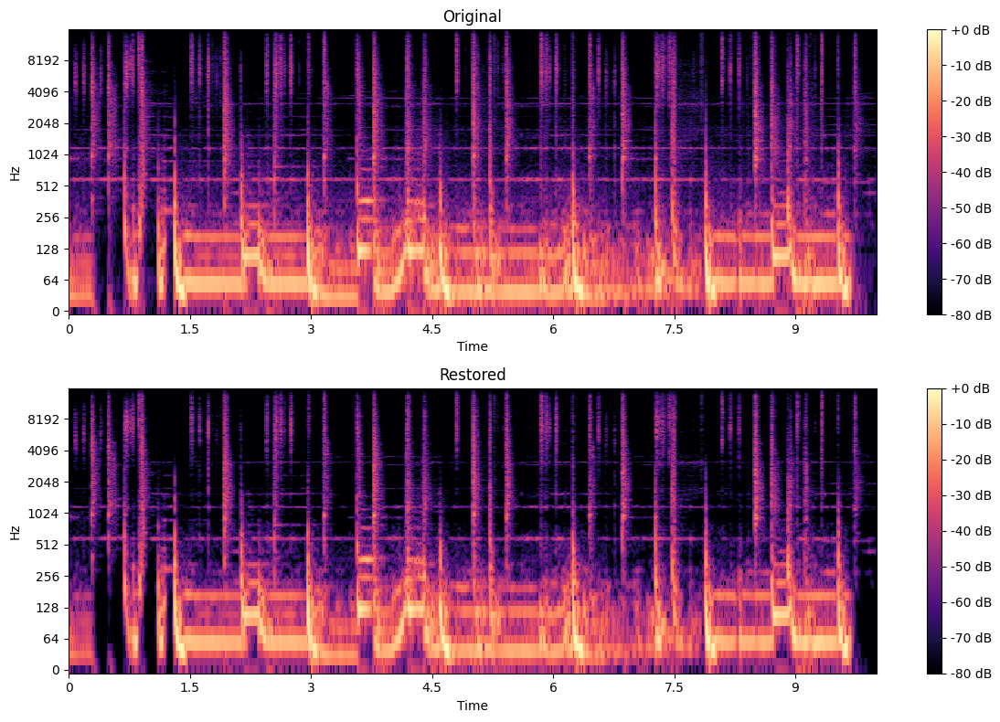

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_02.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_02_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_02.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_02_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


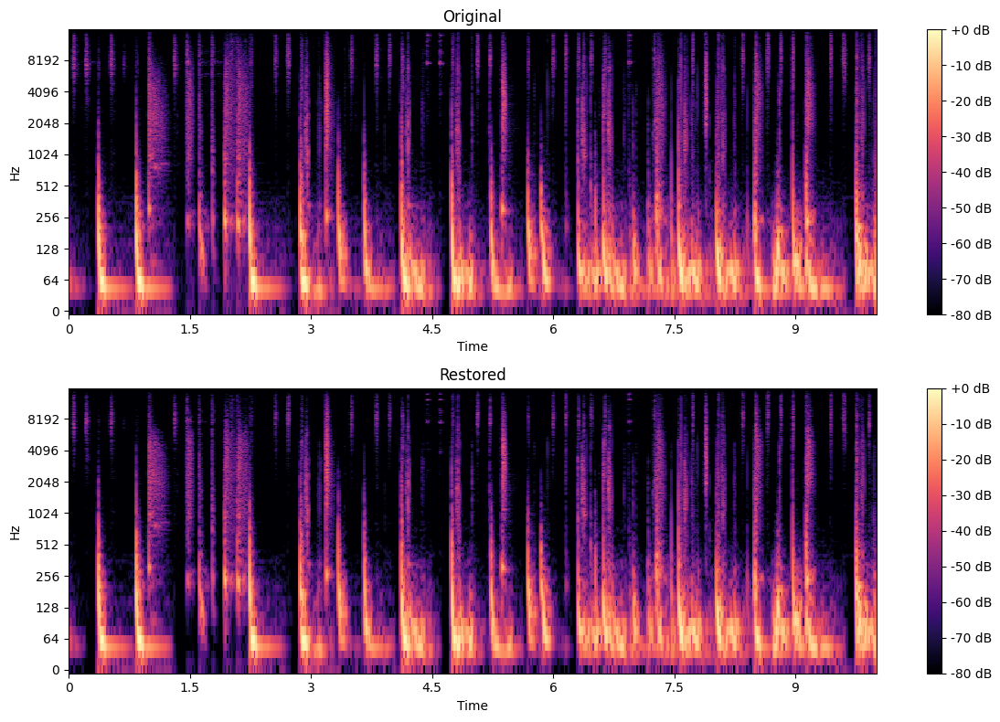

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_03.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_03_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_03.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_03_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


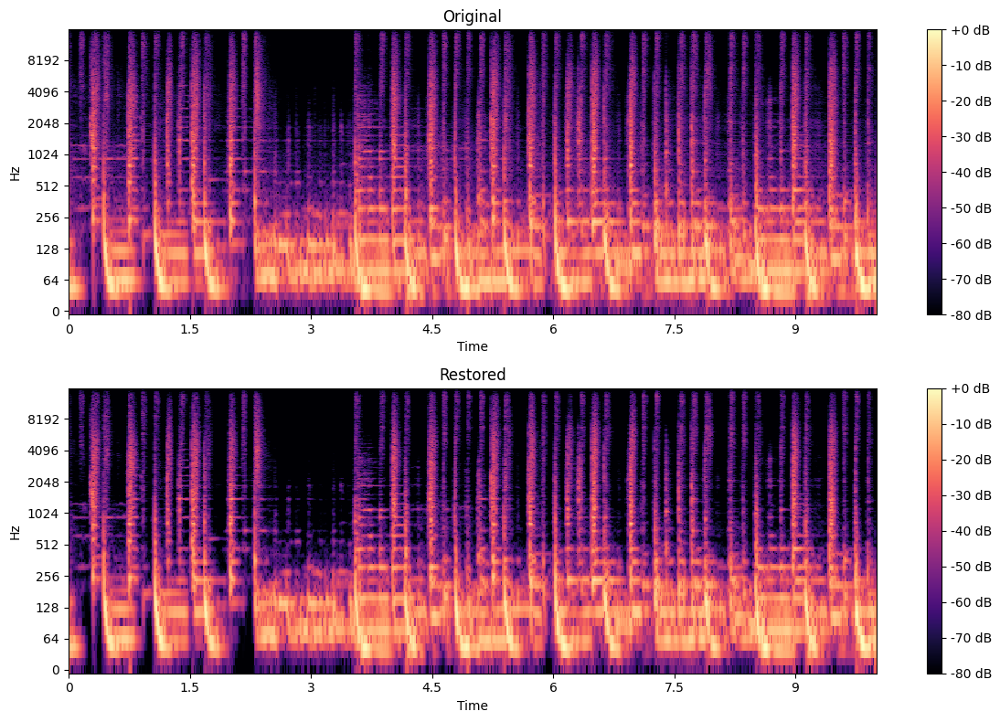

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_04.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_04_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_04.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_04_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


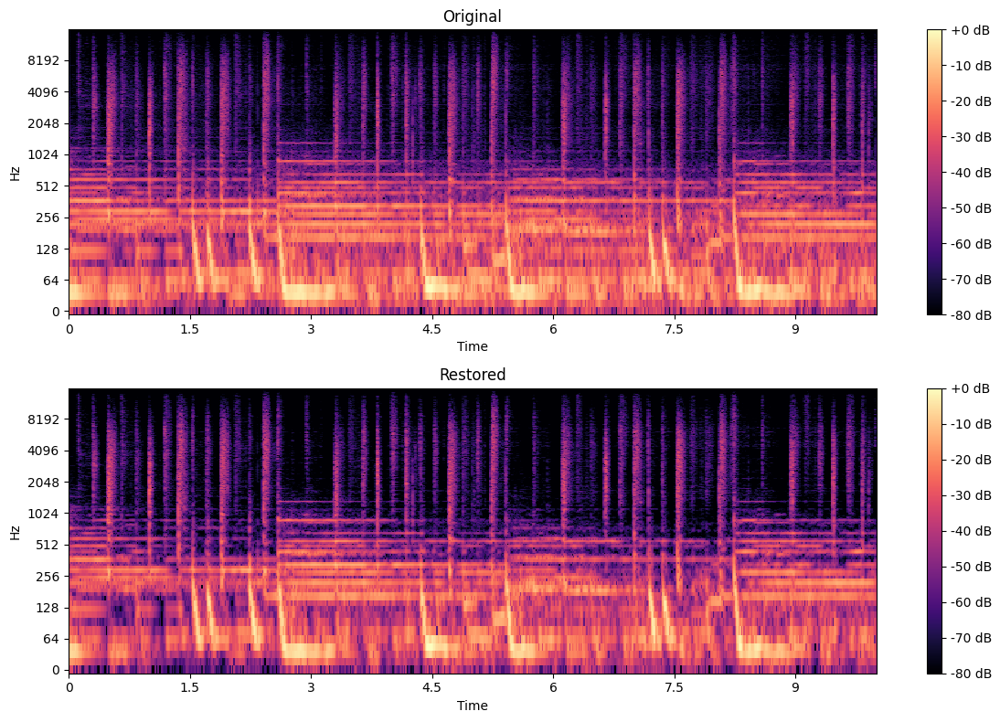

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_05.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_05_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_05.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_05_restored.wav


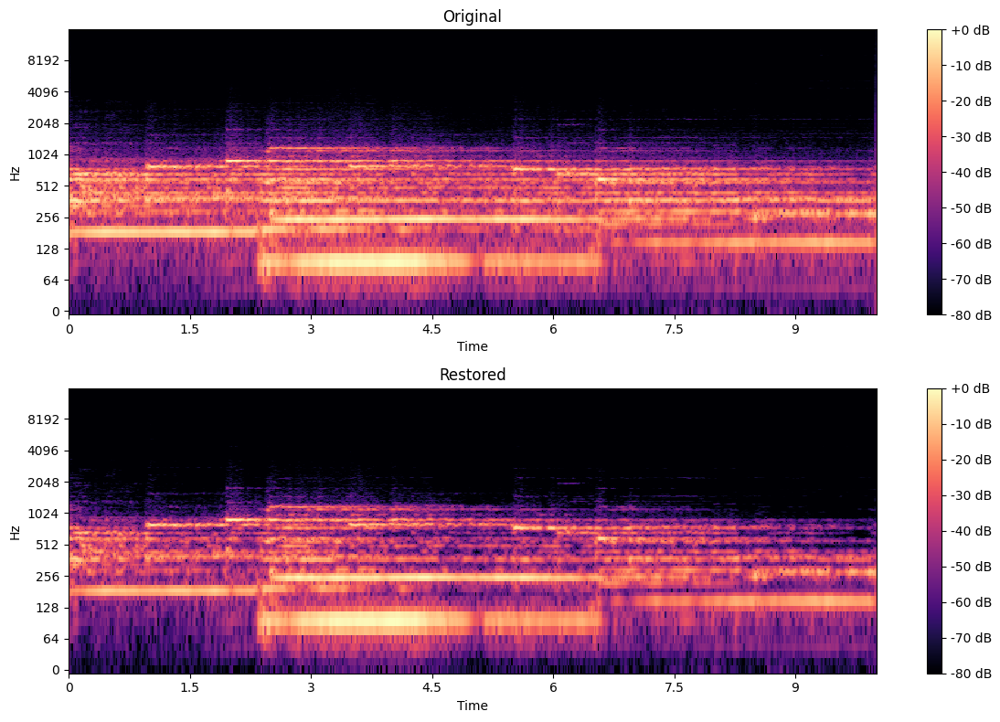

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_06.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_06_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_06.wav
[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_06_restored.wav


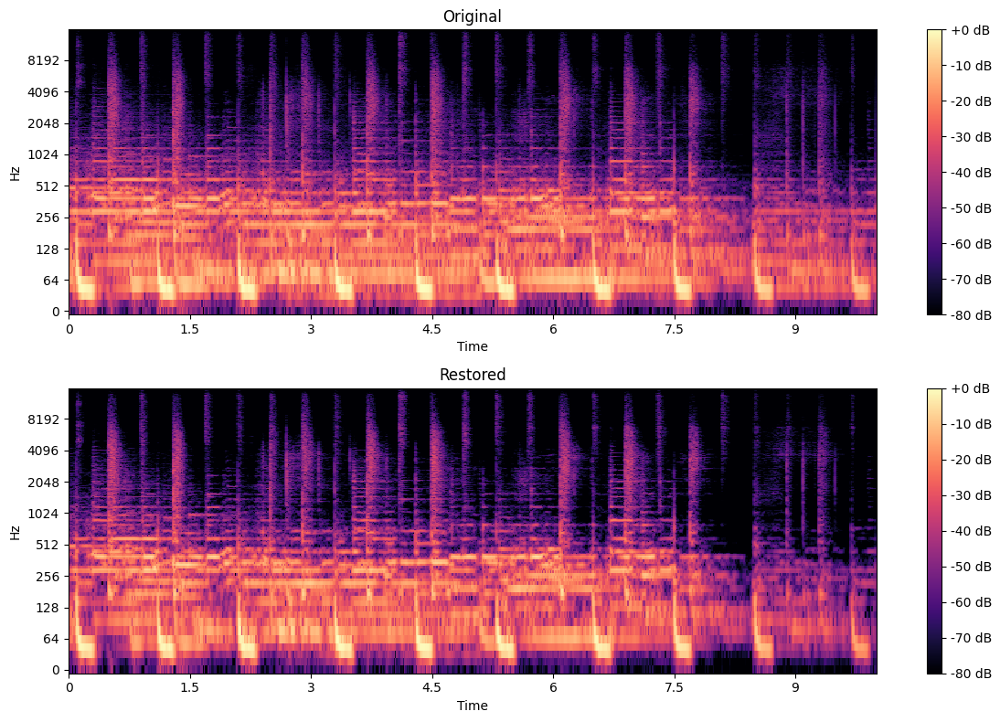

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_07.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_07_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_07.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_07_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


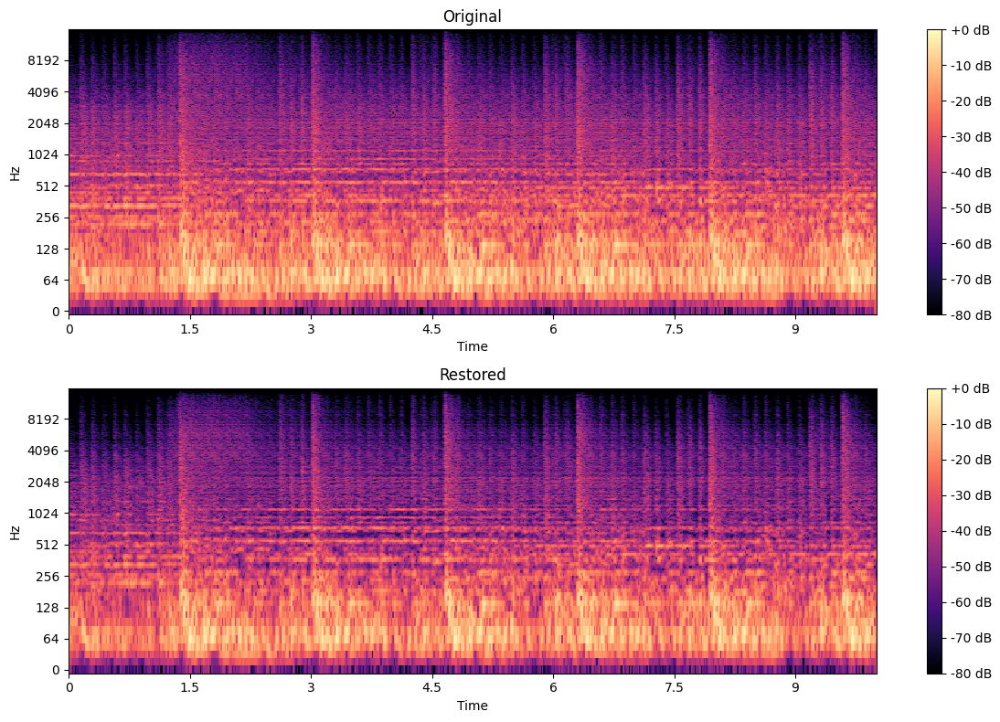

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_08.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_08_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_08.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_08_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


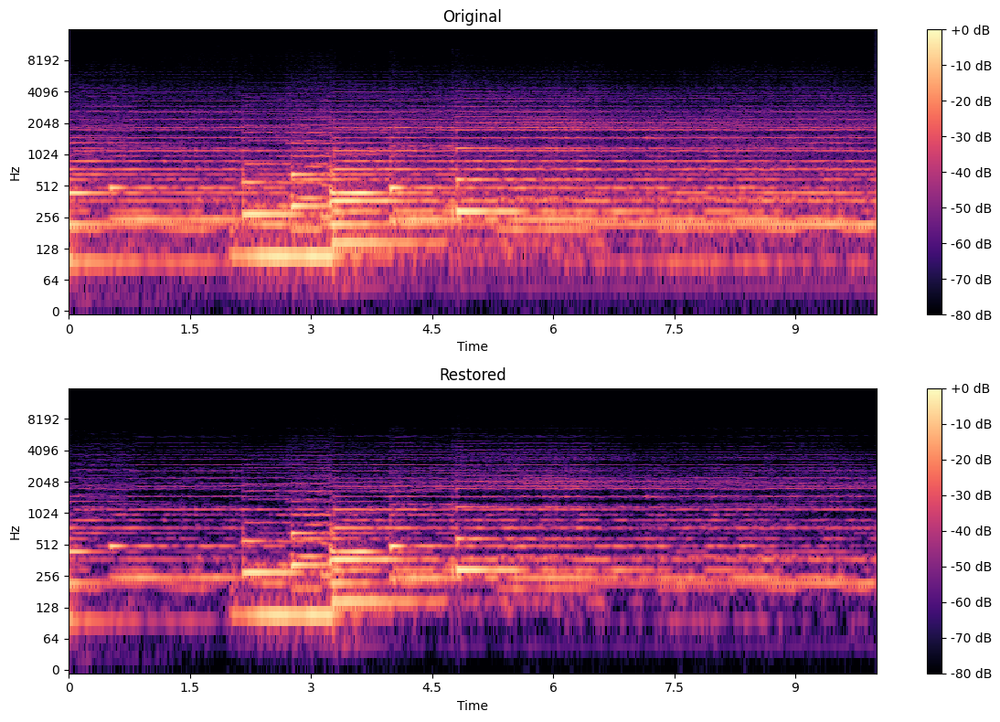

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_09.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_09_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_09.wav
[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_09_restored.wav


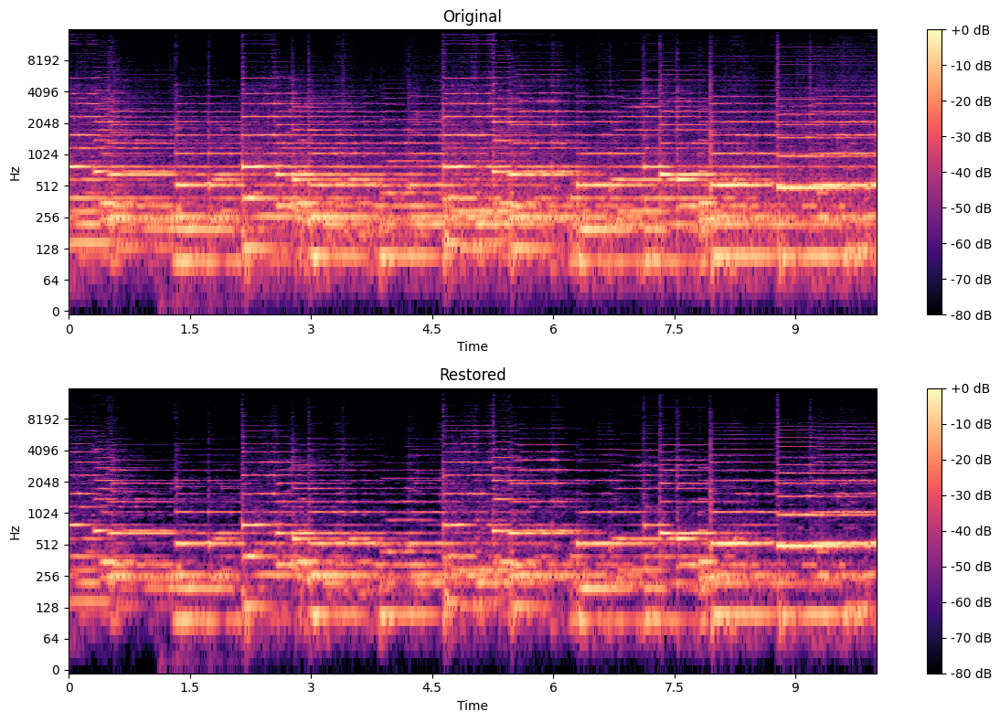

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_10.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_10_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_10.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_10_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


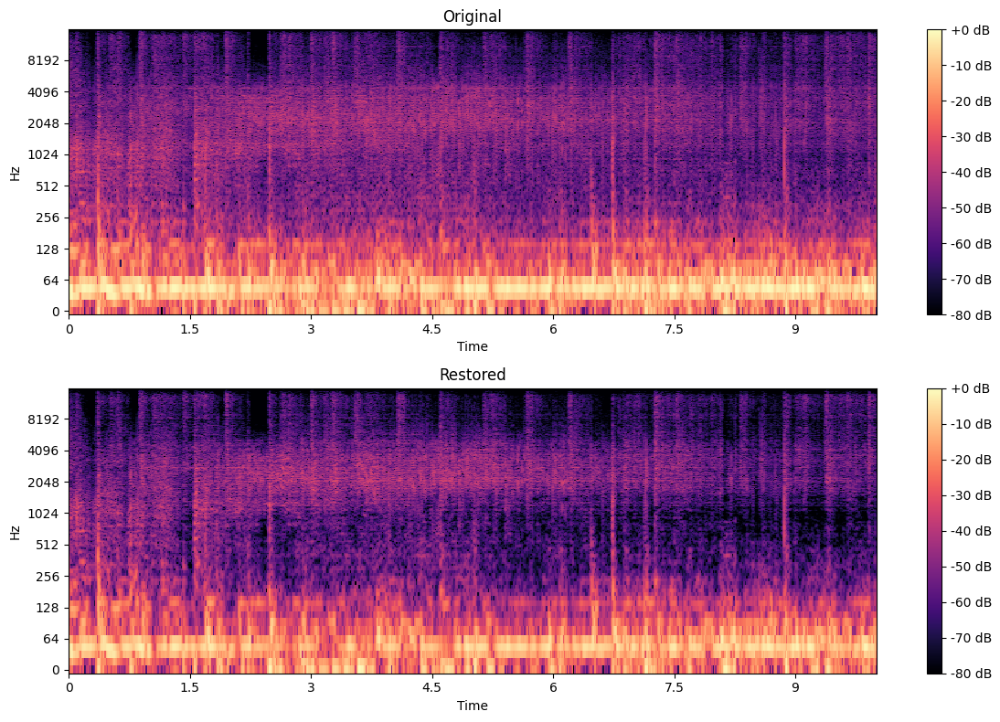

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_11.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_11_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_11.wav
[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_11_restored.wav


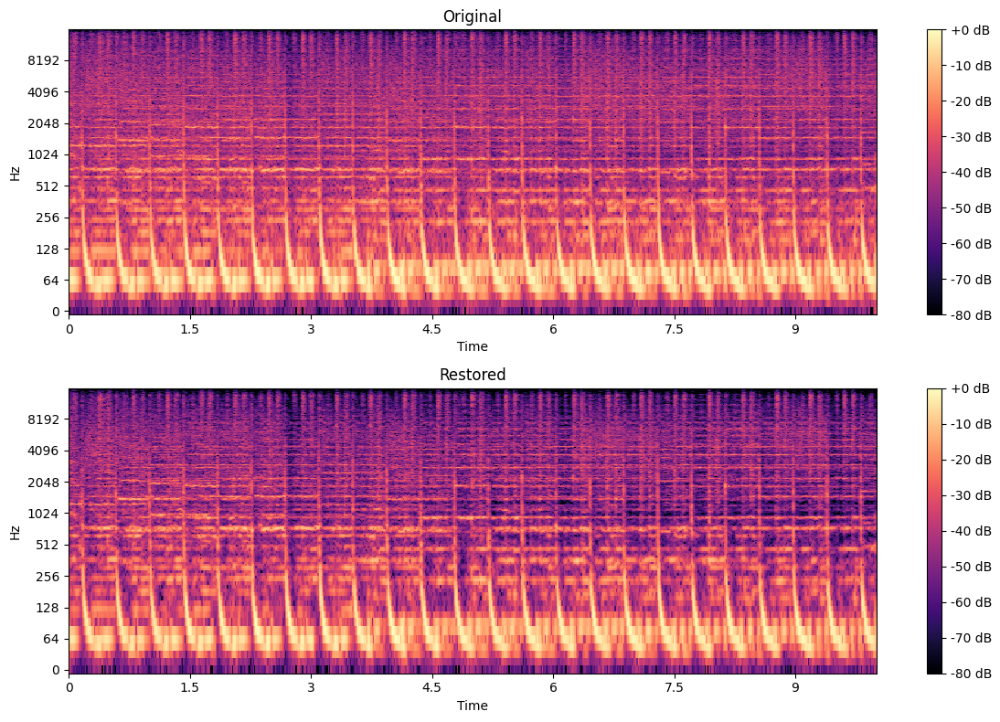

Before:


After:


[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_12.wav
[INFO] DSP upsampled from 32000 Hz → 48000 Hz
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_dsp/musicgen_sample_12_restored.wav
[INFO] Processing: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_12.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


[INFO] Adaptive HF ML blending applied: hf_alpha=0.7
[DONE] Saved: /content/drive/MyDrive/MusicGen/restored_outputs_hybrid/musicgen_sample_12_restored.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


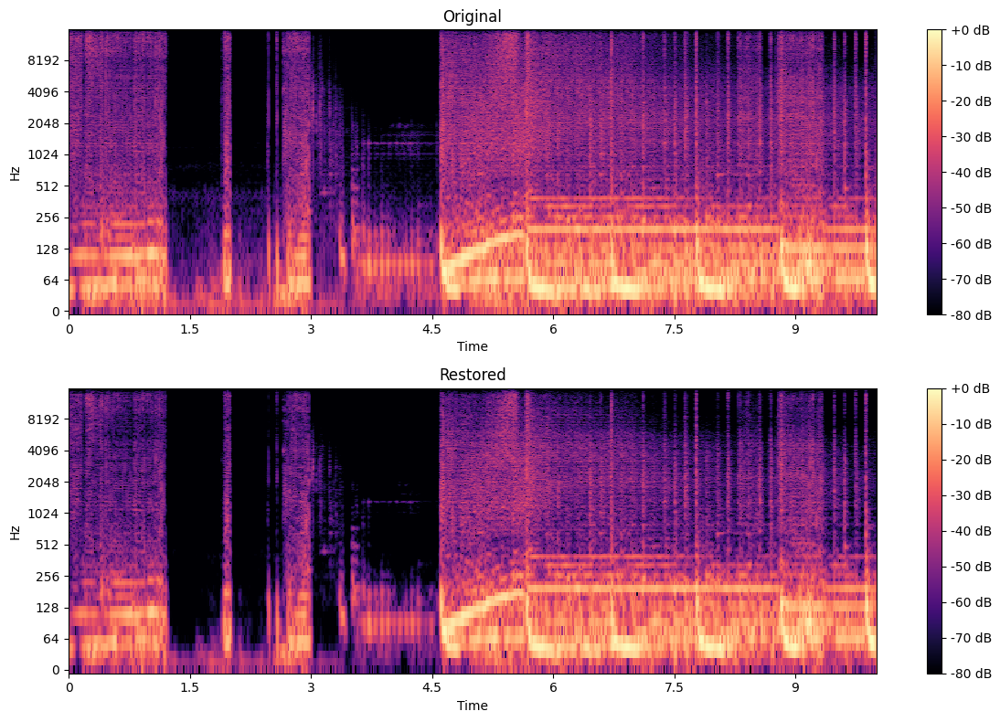

Before:


After:


In [29]:
# Process each .wav file in the input folder
for f in glob.glob(os.path.join(input_folder, '*.wav')):
    # Apply restoration pipeline
    # Restoration only with DSP
    restore_audio(f, output_dsp_folder, use_ml_sr=False)
    # Restoration only with Hybrid
    before, after, sr = restore_audio(f, output_hybrid_folder, use_ml_sr=use_ml_sr_flag, ml_model=model, ml_processor=processor)

    # Load original and restored audio
    x_before, _ = load_audio(before, sr)
    x_after, _ = load_audio(after, sr)

    # Prepare filenames for spectrograms
    base_name = Path(f).stem

    # Save and/or display the comparison spectrogram
    spectrograms(
        raw_audio=x_before,
        restored_audio=x_after,
        sr=sr,
        base_filename=base_name,
        show=True,
        save=True
    )

    # Play audio for comparison
    print('Before:')
    display(Audio(x_before, rate=sr))
    print('After:')
    display(Audio(x_after, rate=sr))

## 9️⃣ Audio Metrics Computation

This cell defines functions to compute **key audio metrics** for evaluation:

- **Integrated Loudness (LUFS)** to measure perceived volume.  
- **Crest Factor** to assess peak-to-RMS ratio.  
- **Dynamic Range** to quantify amplitude variation.  
- **Bandwidth at -20 dB** to estimate frequency coverage.   

These metrics are useful to **quantitatively evaluate** the effectiveness of audio restoration.

**Action:** Run this cell to load all audio analysis functions for later evaluation.

In [14]:
# Compute integrated loudness (LUFS)
def compute_lufs(audio, sr):
    meter = pyln.Meter(sr)
    return meter.integrated_loudness(audio)

# Compute crest factor in dB (peak / RMS)
def crest_factor_db(audio):
    peak = np.max(np.abs(audio))
    rms = np.sqrt(np.mean(audio**2))
    return 20*np.log10(peak / rms)

# Approximate dynamic range in dB (95th percentile vs RMS)
def dynamic_range_db(audio):
    p95 = np.percentile(np.abs(audio), 95)
    rms = np.sqrt(np.mean(audio**2))
    return 20*np.log10(p95 / rms)

# Compute approximate bandwidth where amplitude is above -20 dB
def bandwidth_20db(audio, sr):
    S = np.abs(librosa.stft(audio, n_fft=4096))
    freqs = librosa.fft_frequencies(sr=sr, n_fft=4096)
    avg_mag_db = librosa.amplitude_to_db(np.mean(S, axis=1), ref=np.max)
    idx = np.where(avg_mag_db > -20)[0]
    return freqs[idx[-1]] if len(idx) > 0 else 0

## 🔟 Evaluate Restored Audio Variants

This cell evaluates all audio files in the input folder across multiple **restoration variants**:

- **Brut**: original audio without processing.  
- **Denoise**: applying spectral denoising.  
- **Denoise + LUFS**: denoising plus loudness normalization.  
- **Denoise + LUFS + HF**: full pipeline including high-frequency restoration.  

For each variant, the following **audio metrics** are computed:

- **Integrated Loudness (LUFS)**  
- **Crest Factor (dB)**  
- **Dynamic Range (dB)**  
- **Bandwidth at -20 dB (Hz)**  
- **Residual Noise Energy (RMS)**  

The results are stored in a **DataFrame** for comparison.

**Action:** Run this cell to compute metrics for all audio variants and review the evaluation table.

In [15]:
# List all .wav files in the input folder
input_folder = Path(input_folder)  # transforme la string en Path
files = list(input_folder.glob("*.wav"))
results = []

# Compute metrics for each restoration variant
for f in files:
    # Load original audio
    y, sr = librosa.load(f, sr=None, mono=True)

    # Compute variants (Brut + full restored)
    variants = {
        "Raw": y,
        "Restored": hf_restore(loudness_normalize(spectral_denoise(y, sr), sr), sr)
    }

    for name, sig in variants.items():
        results.append({
            "File": f.stem,
            "Variant": name,
            "LUFS": compute_lufs(sig, sr),
            "CrestFactor_dB": crest_factor_db(sig),
            "DR_dB": dynamic_range_db(sig),
            "Bandwidth_-20dB_Hz": bandwidth_20db(sig, sr),
        })

# Convert to DataFrame
df_results = pd.DataFrame(results)

# Save metrics to CSV in plots folder
plots_dir = Path("/content/drive/MyDrive/MusicGen/plots")
metrics_file = plots_dir / "metrics_results.csv"
df_results.to_csv(metrics_file, index=False)

print(f"✅ Metrics saved to {metrics_file}")
df_results

/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")
/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")
/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")
/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")
/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")
/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possib

✅ Metrics saved to /content/drive/MyDrive/MusicGen/plots/metrics_results.csv


,File,Variant,LUFS,CrestFactor_dB,DR_dB,Bandwidth_-20dB_Hz
0,musicgen_sample_01,Raw,-19.227936,15.233846,6.259521,218.7500
1,musicgen_sample_01,Restored,-21.944603,16.841218,6.662419,226.5625
2,musicgen_sample_02,Raw,-18.578475,15.274887,7.709321,257.8125
3,musicgen_sample_02,Restored,-20.578216,15.626730,7.777710,304.6875
4,musicgen_sample_03,Raw,-17.154793,13.838255,6.704471,468.7500
5,musicgen_sample_03,Restored,-20.433771,16.061326,6.892880,468.7500
6,musicgen_sample_04,Raw,-17.184253,13.072081,6.674323,554.6875
7,musicgen_sample_04,Restored,-18.694037,13.769168,6.970577,882.8125
8,musicgen_sample_05,Raw,-15.895417,13.914413,6.393479,898.4375
9,musicgen_sample_05,Restored,-18.186823,14.457315,6.843955,898.4375


## 1️⃣1️⃣ Mini Listening Test (MUSHRA-style)

This cell performs a **mini MUSHRA-style listening test** on a randomly selected audio file from the input folder. The test allows subjective evaluation of **perceived audio quality** across different processing stages:

- **A**: original audio (Brut)  
- **B**: denoised audio  
- **C**: denoised and loudness-normalized  
- **D**: full pipeline including high-frequency restoration  

The order of playback is randomized to avoid bias. Users can **rate each excerpt from 0 to 100** based on perceived quality.

**Action:** Run this cell, listen to each excerpt, and note subjective quality ratings.

In [16]:
# List all .wav files in the input folder
files = glob.glob(f"{input_folder}/*.wav")

# Select a random file for testing
test_file = random.choice(files)
print(f"[INFO] Test on: {test_file}")

# Load audio
y, sr = librosa.load(test_file, sr=None)

# Generate different processing versions
versions = {
    "A": y,
    "B": spectral_denoise(y, sr),
    "C": loudness_normalize(spectral_denoise(y, sr), sr),
    "D": hf_restore(loudness_normalize(spectral_denoise(y, sr), sr), sr)
}

# Randomize playback order
keys = list(versions.keys())
random.shuffle(keys)

# Display audio for listening test
print("Mini MUSHRA - rate each excerpt from 0 to 100 (perceived quality)")
for k in keys:
    print(f"Excerpt {k}")
    display(Audio(versions[k], rate=sr))

[INFO] Test on: /content/drive/MyDrive/MusicGen/outputs/musicgen_sample_03.wav


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


Mini MUSHRA - rate each excerpt from 0 to 100 (perceived quality)
Excerpt D


/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


Excerpt A


Excerpt B


Excerpt C


## 1️⃣2️⃣ Compute Metrics for Original and Restored Audio

This cell computes **objective audio quality metrics** for each file in the input folder.  
Both the **original** and the **restored** versions are evaluated using key indicators:

- **LUFS**: perceived loudness (dB)  
- **Dynamic Range (DR)**: contrast between loud and quiet parts  
- **Bandwidth (-20dB)**: effective frequency range preserved  

The results are aggregated into a DataFrame and visualized with bar plots to compare average values and per-file differences.

**Action:** Run this cell to calculate and visualize objective quality improvements.

In [17]:
# Function to plot bar charts with value labels
def plot_with_labels(series, title, ylabel, color=None):
    ax = series.plot(kind="bar", color=color)
    plt.title(title)
    plt.ylabel(ylabel)
    for i, v in enumerate(series):
        plt.text(i, v, f"{v:.2f}", ha="center", va="bottom", fontsize=9)
    plt.tight_layout()

# Function to save the figure
def save_plot(filename):
    plt.savefig(os.path.join(plots_dir, filename))
    plt.show()
    plt.close()

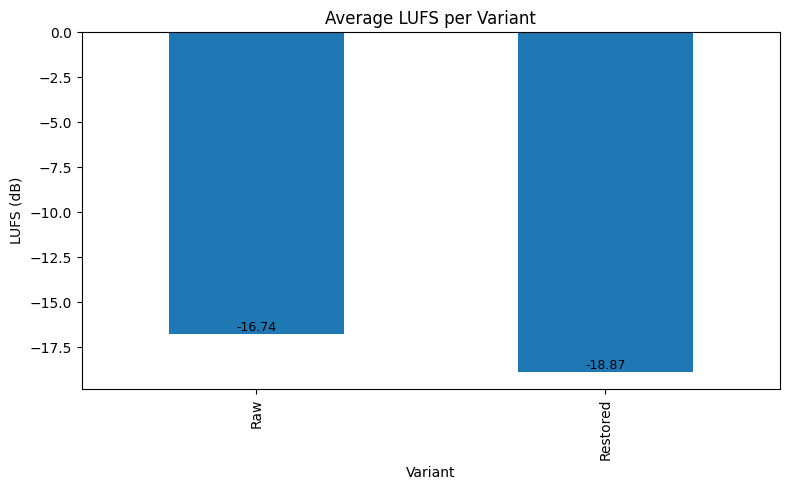

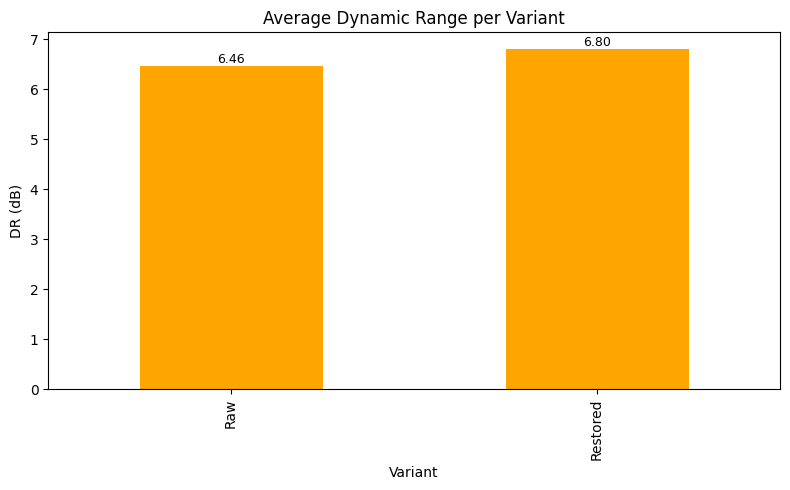

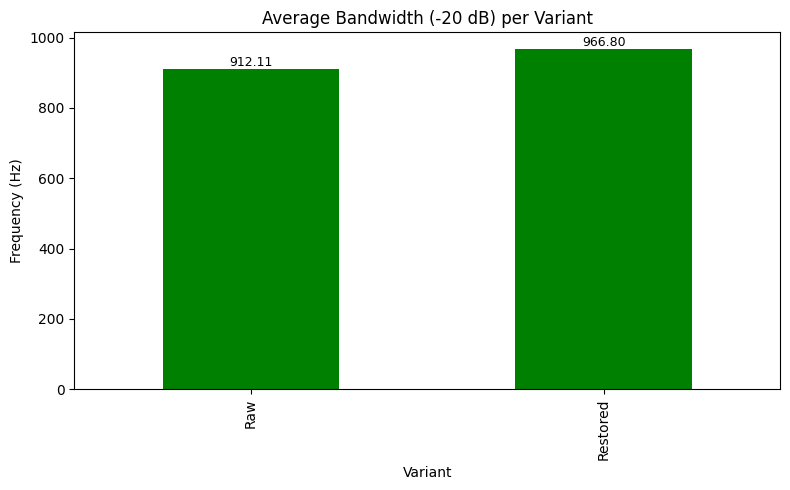

In [18]:
# --- Plot average metrics per restoration variant ---

# Average LUFS per variant
plt.figure(figsize=(8,5))
plot_with_labels(
    df_results.groupby("Variant")["LUFS"].mean(),
    "Average LUFS per Variant",
    "LUFS (dB)"
)
save_plot("Average_LUFS.png")

# Average Dynamic Range (DR) per variant
plt.figure(figsize=(8,5))
plot_with_labels(
    df_results.groupby("Variant")["DR_dB"].mean(),
    "Average Dynamic Range per Variant",
    "DR (dB)",
    color="orange"
)
save_plot("Average_DR.png")

# Average bandwidth above -20 dB per variant
plt.figure(figsize=(8,5))
plot_with_labels(
    df_results.groupby("Variant")["Bandwidth_-20dB_Hz"].mean(),
    "Average Bandwidth (-20 dB) per Variant",
    "Frequency (Hz)",
    color="green"
)
save_plot("Average_Bandwidth.png")


🎵 musicgen_sample_01


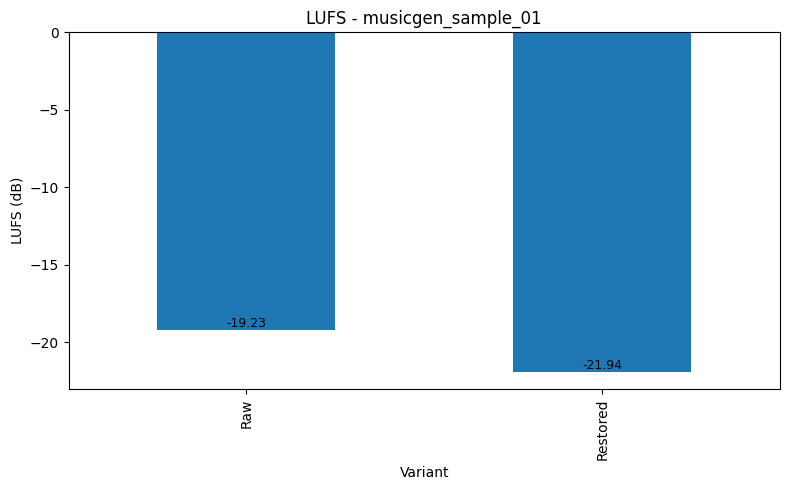

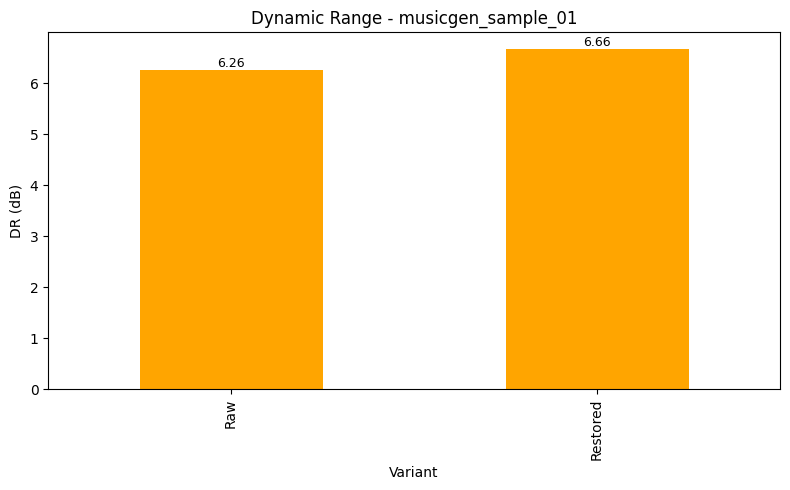

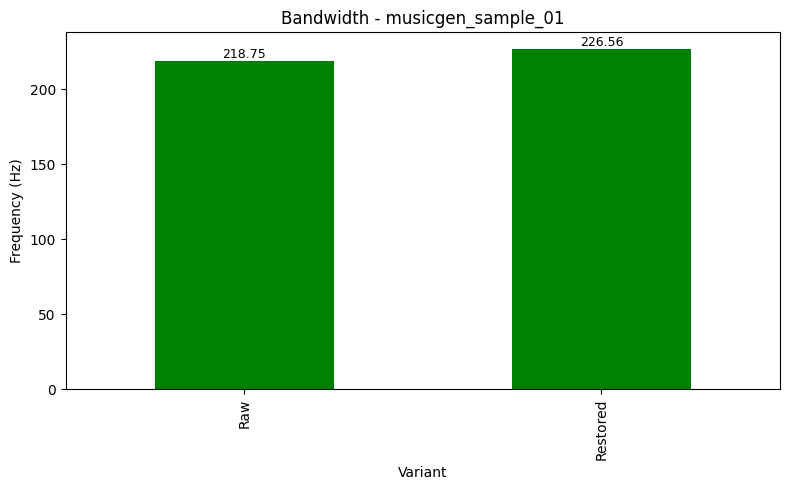


🎵 musicgen_sample_02


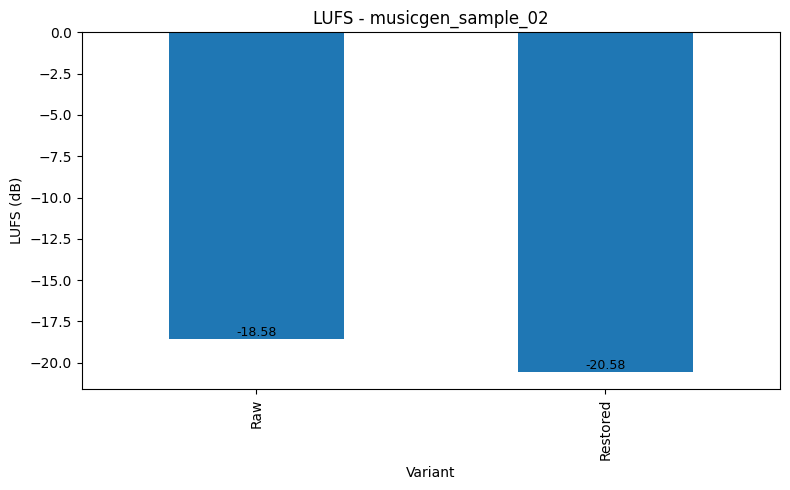

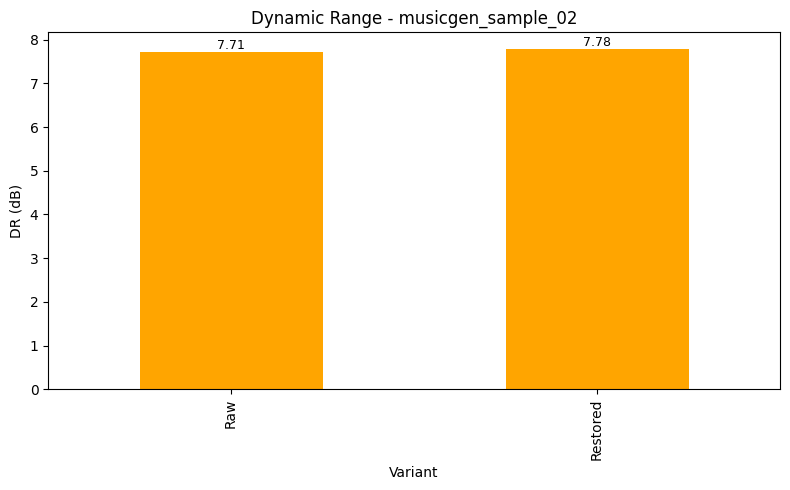

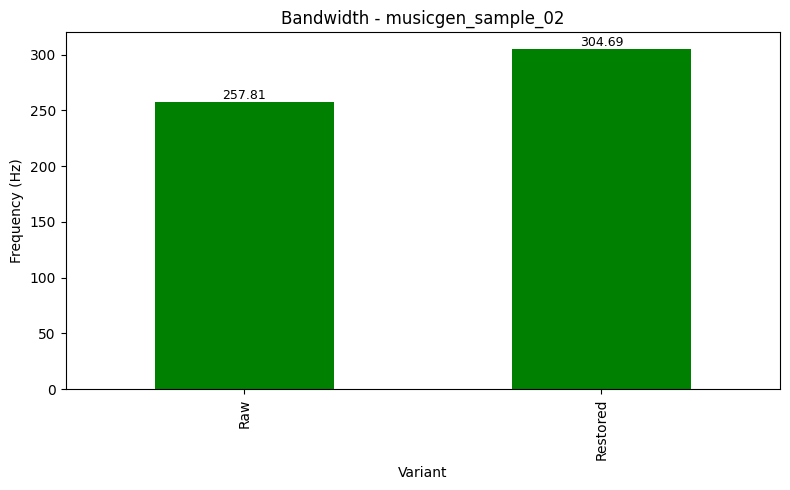


🎵 musicgen_sample_03


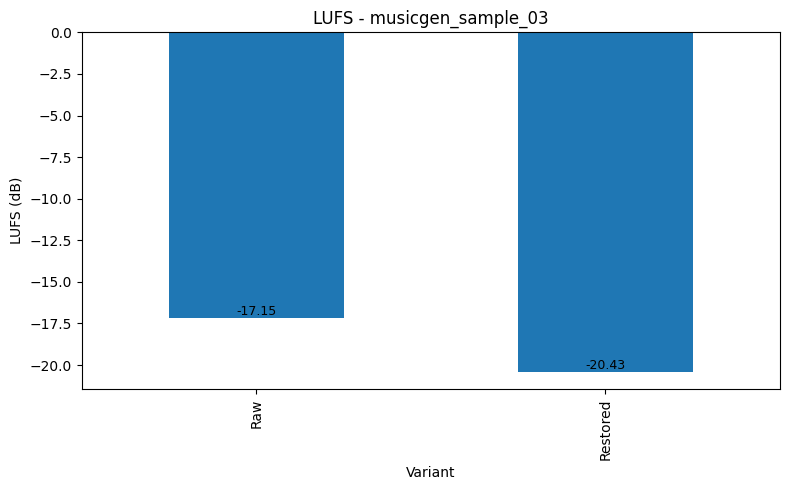

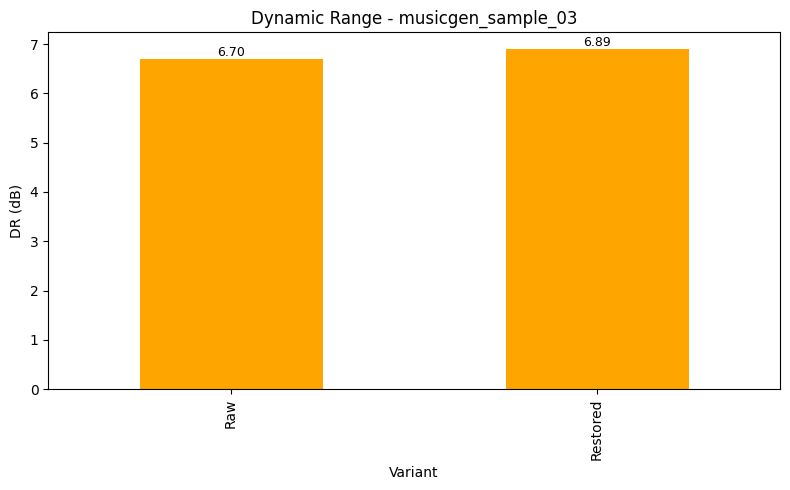

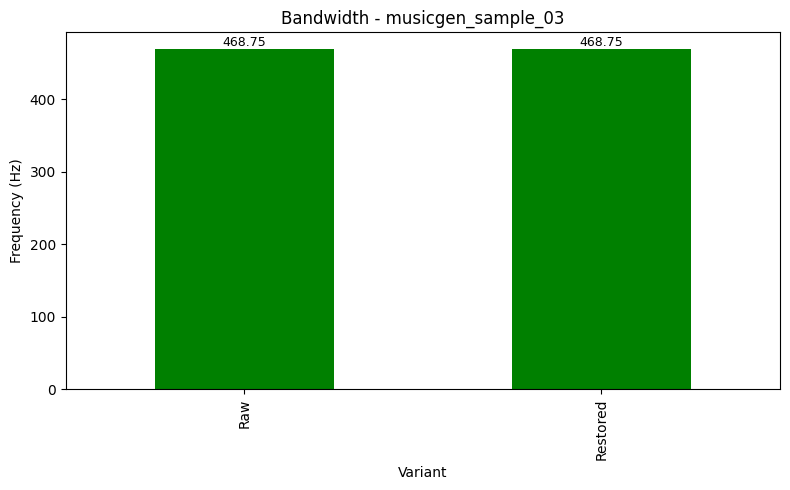


🎵 musicgen_sample_04


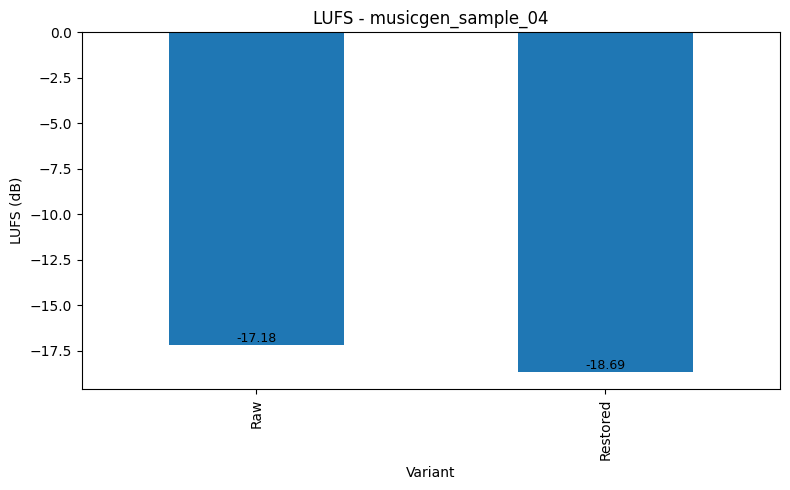

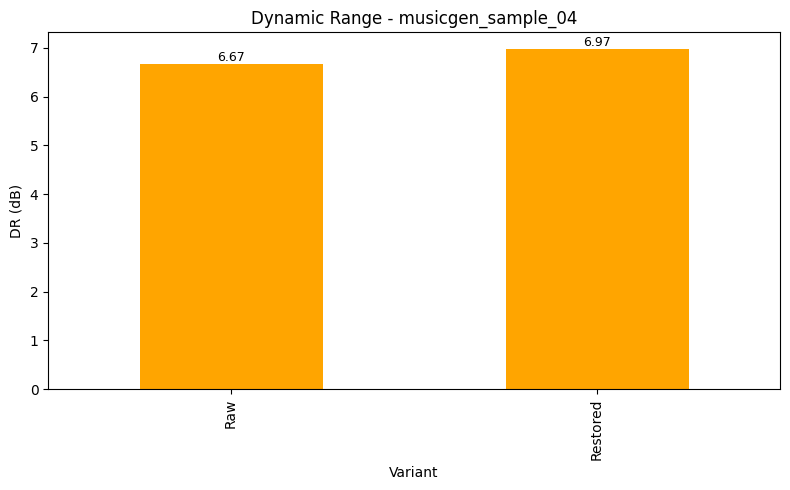

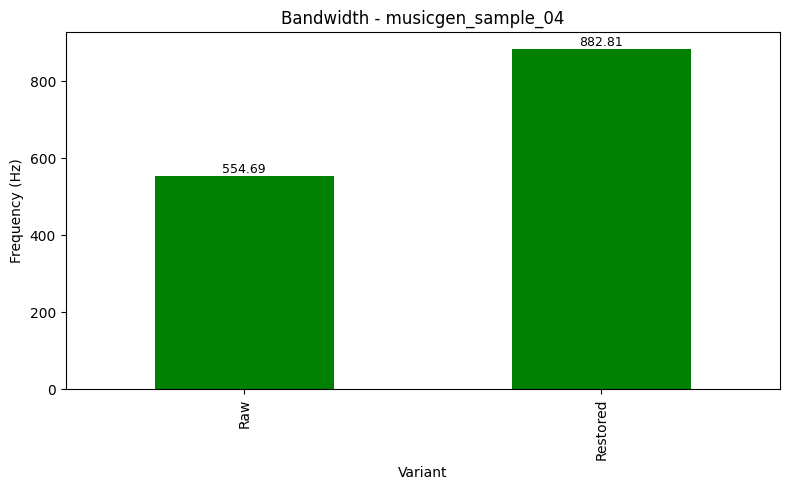


🎵 musicgen_sample_05


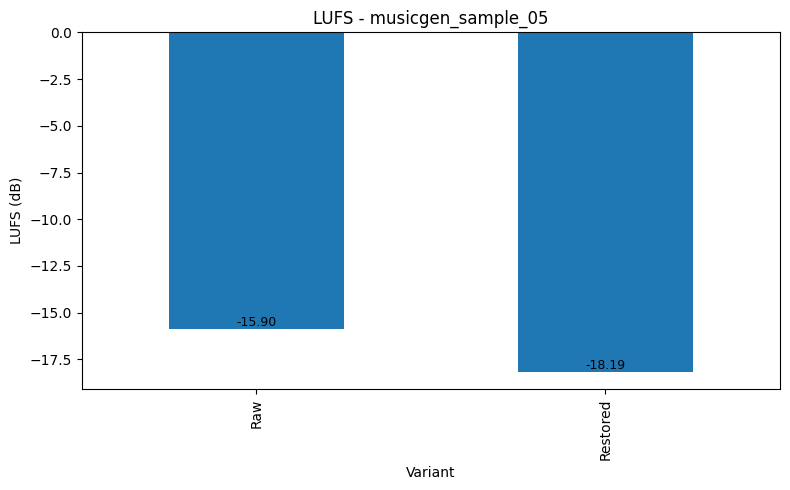

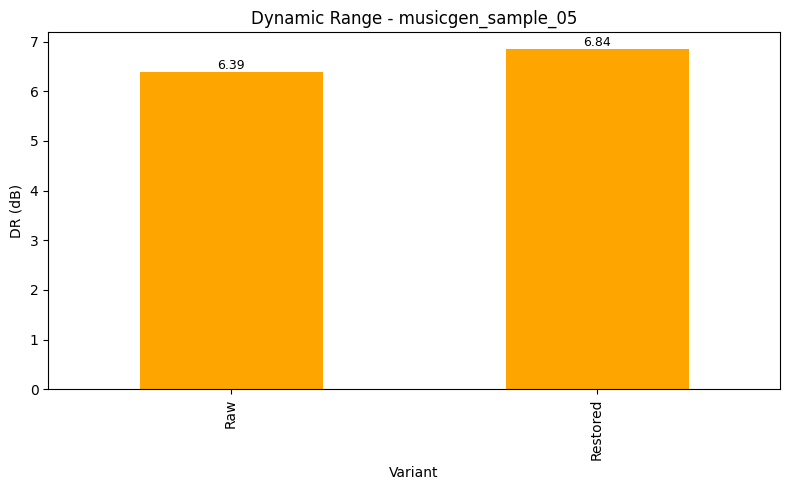

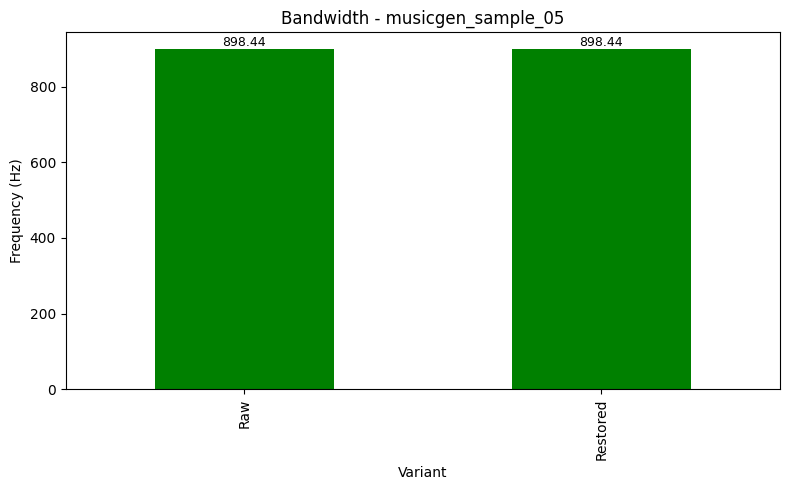


🎵 musicgen_sample_06


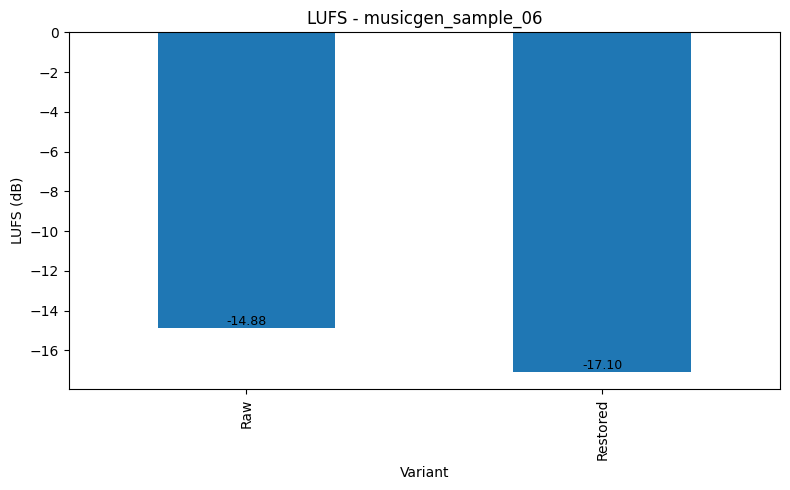

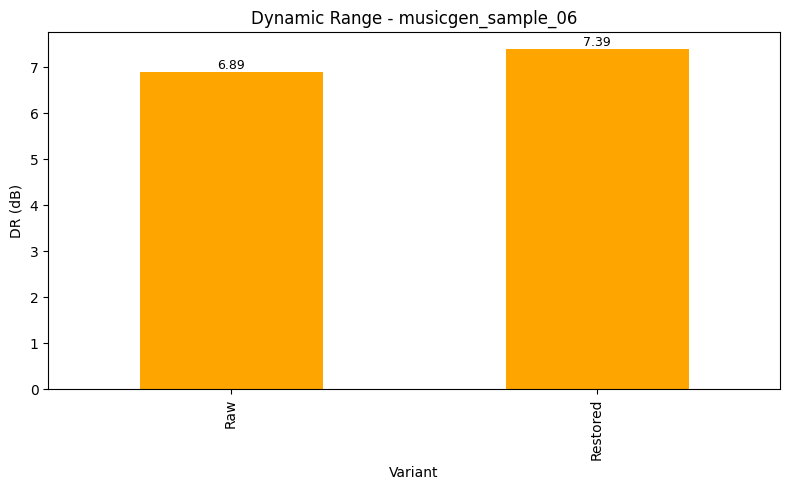

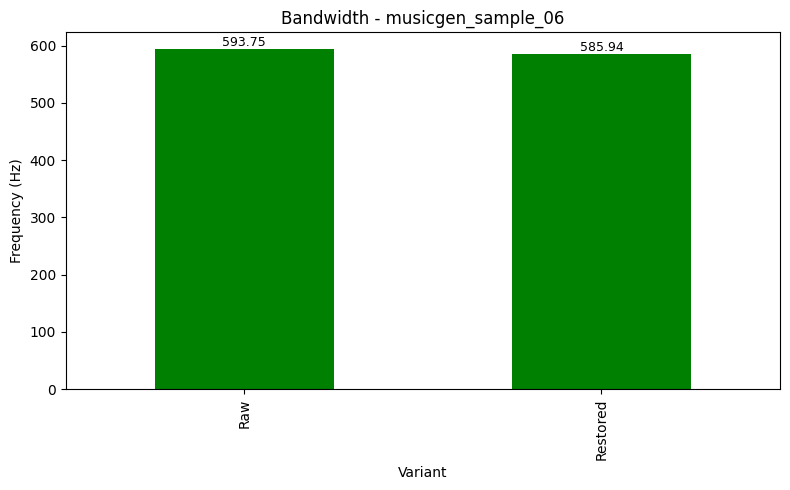


🎵 musicgen_sample_07


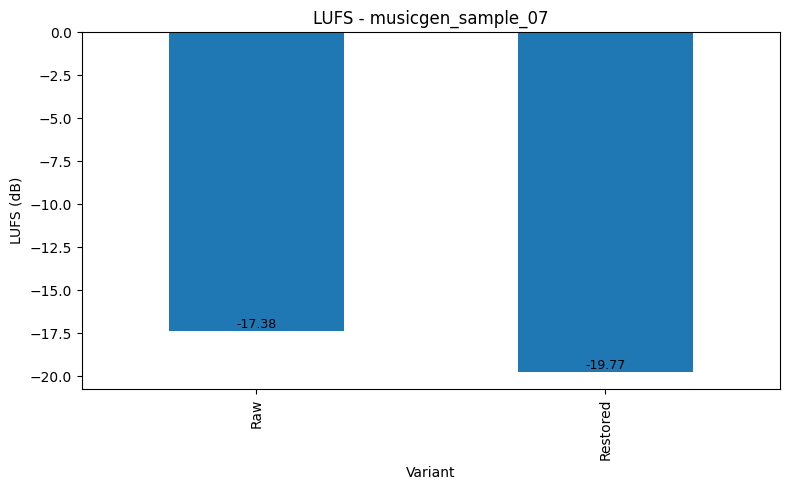

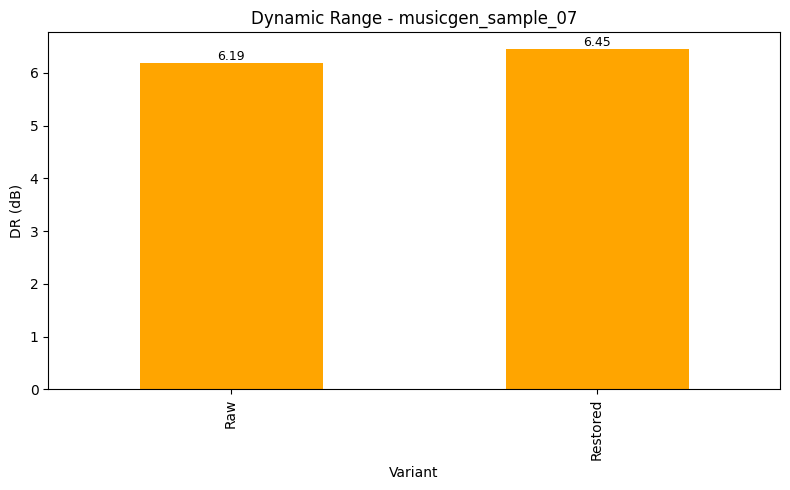

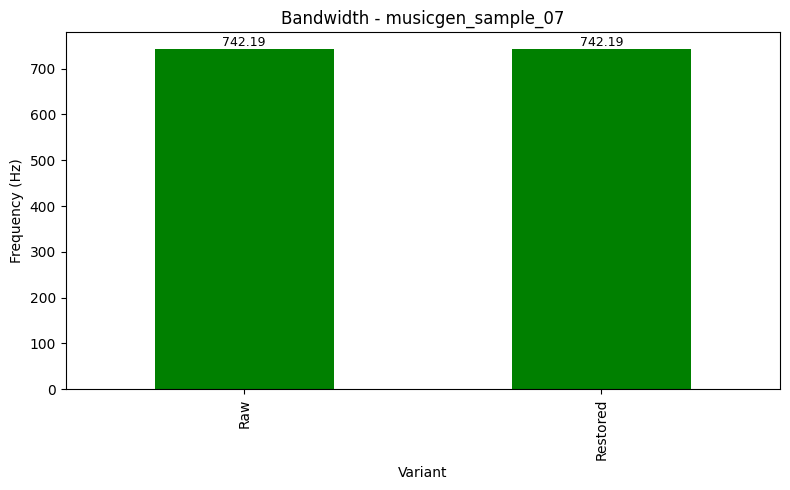


🎵 musicgen_sample_08


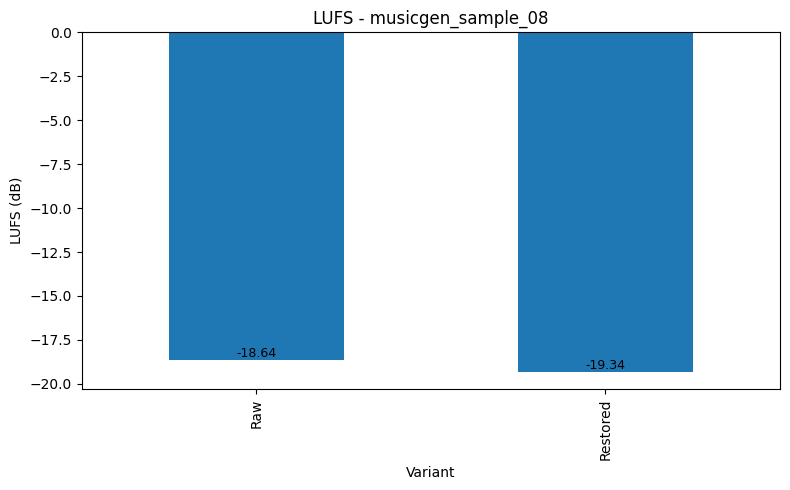

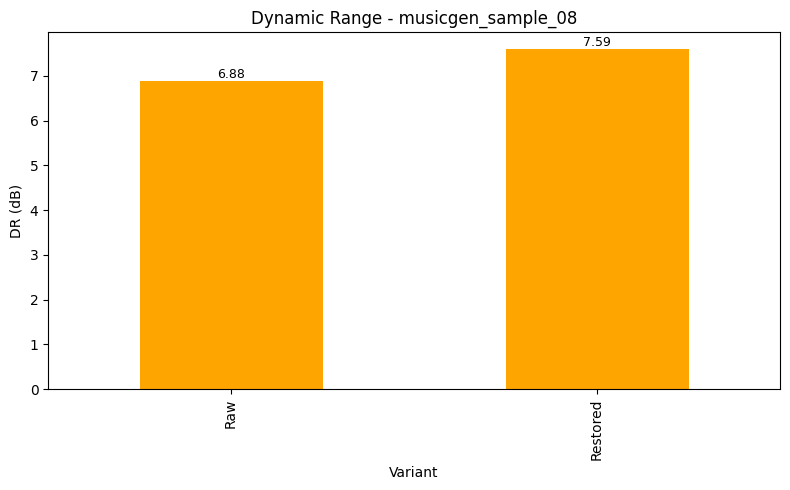

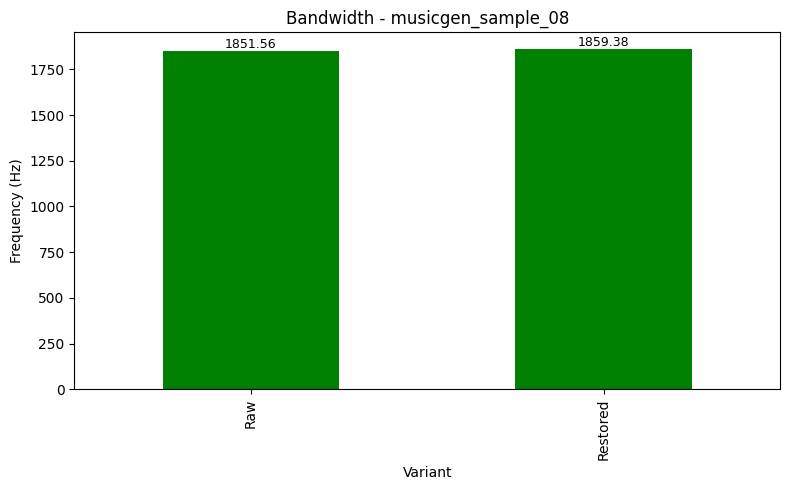


🎵 musicgen_sample_09


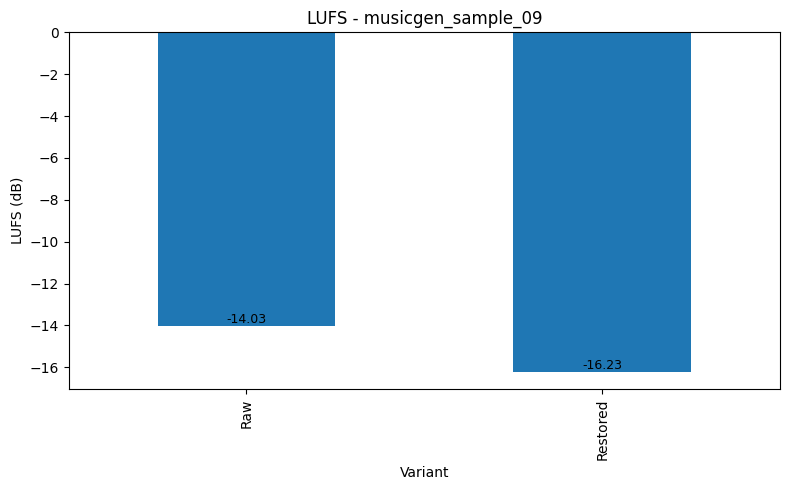

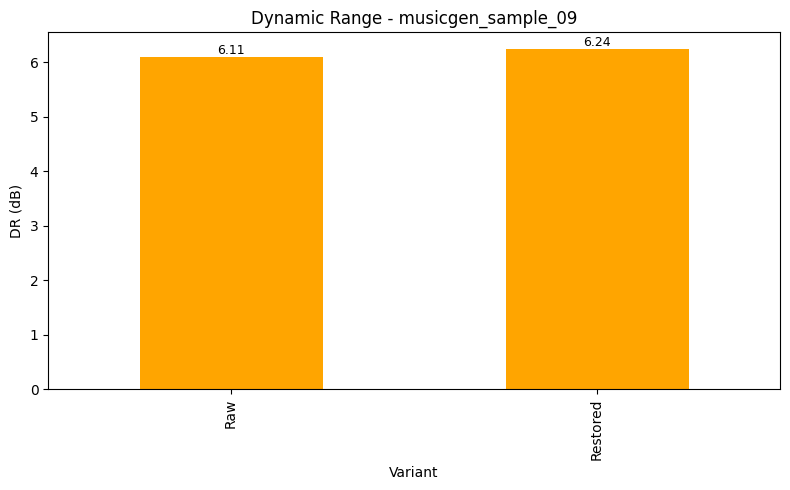

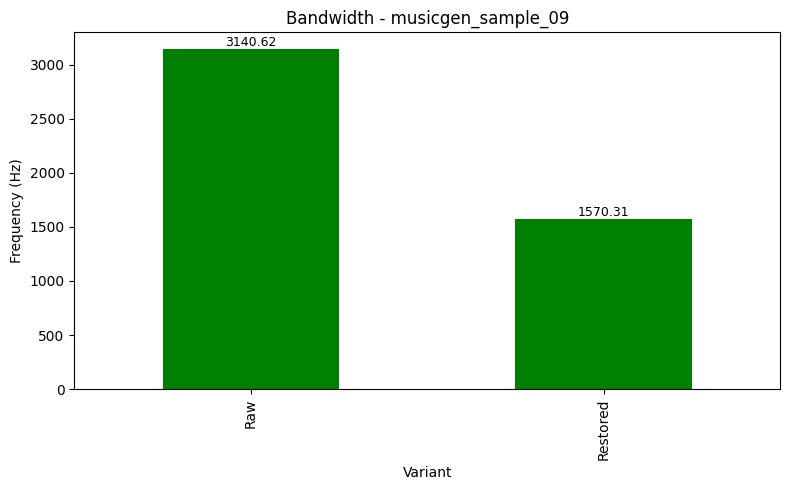


🎵 musicgen_sample_10


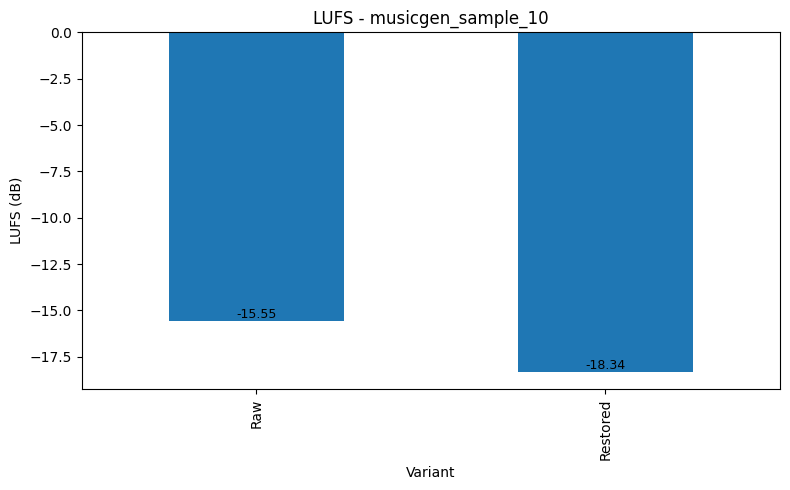

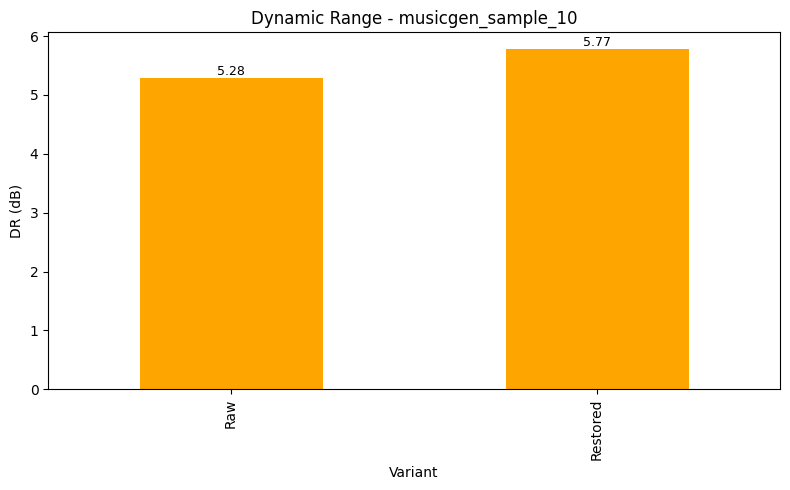

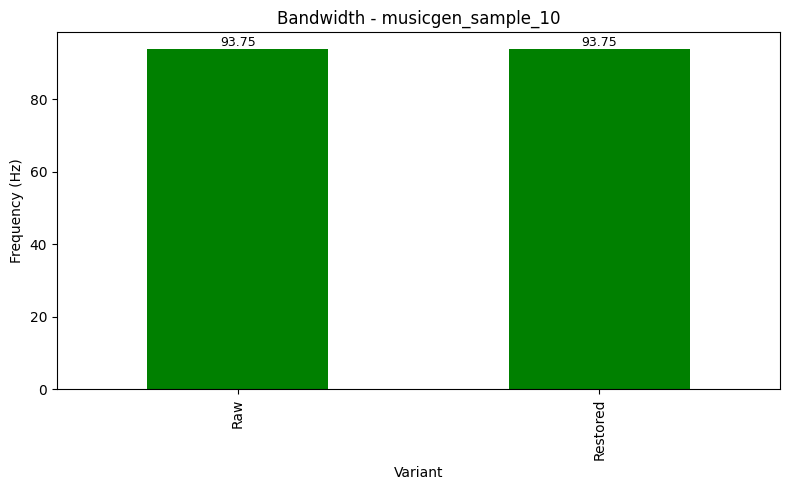


🎵 musicgen_sample_11


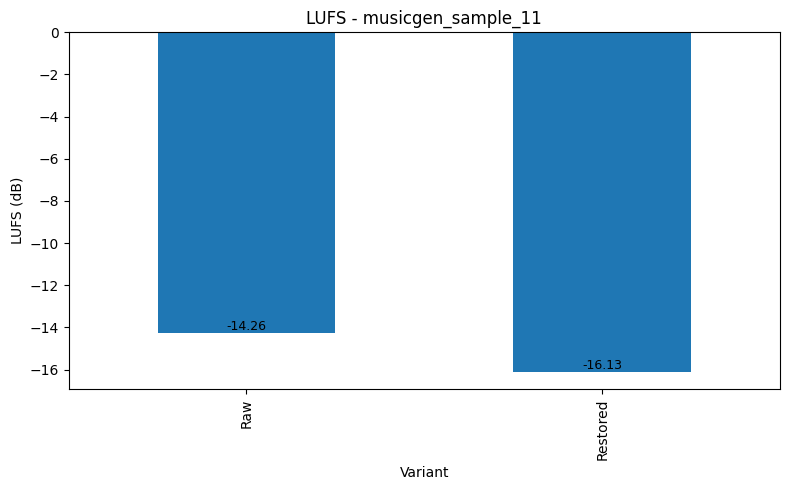

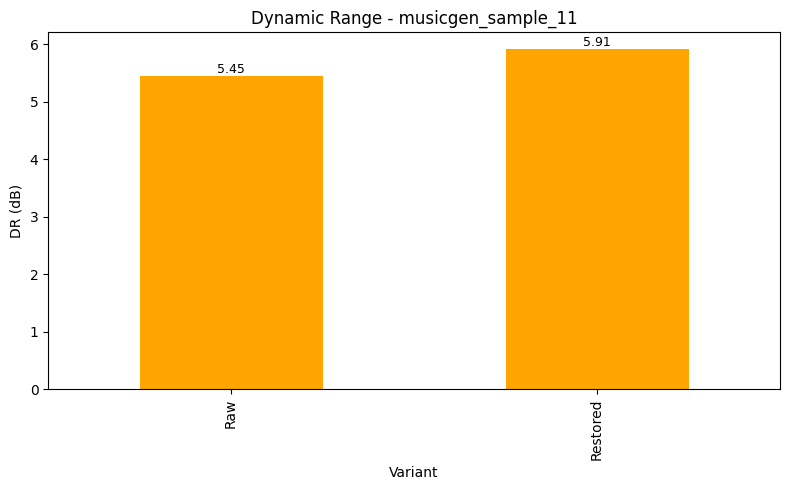

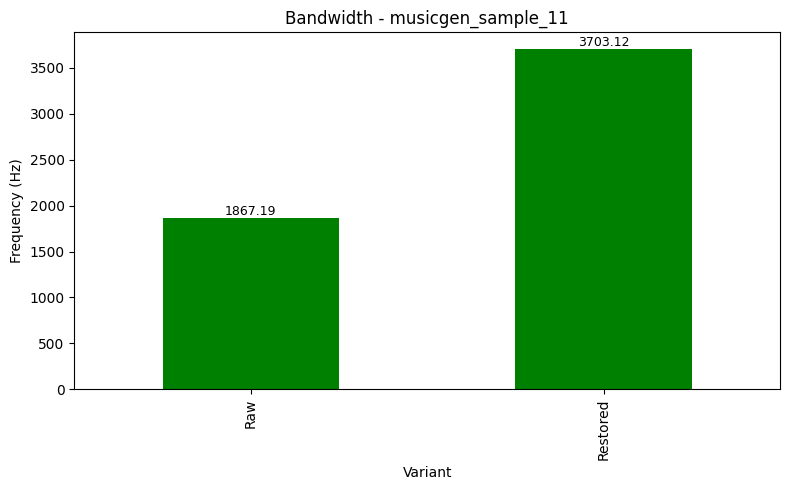


🎵 musicgen_sample_12


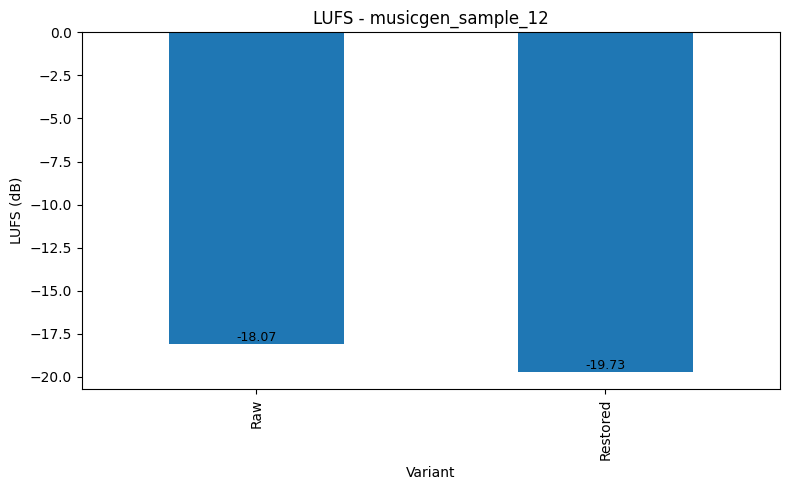

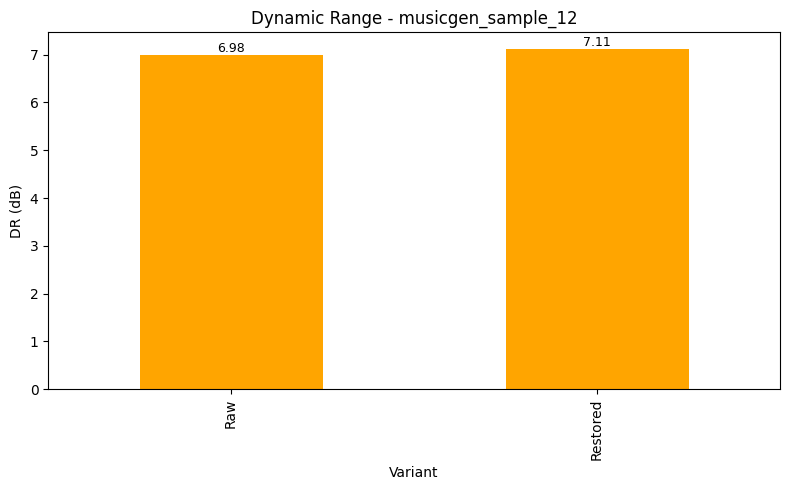

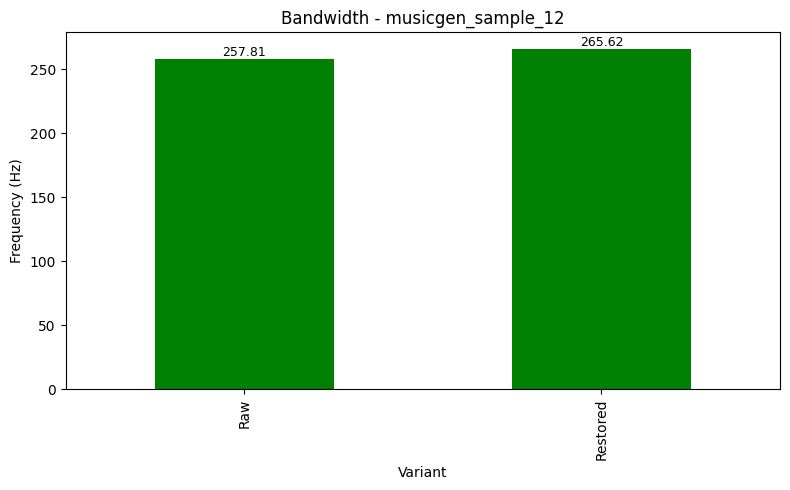

In [19]:
# --- Plot metrics for each individual audio file ---

for fichier, group in df_results.groupby("File"):
    safe_name = fichier.replace(" ", "_").replace(".", "_")
    print(f"\n🎵 {fichier}")

    # LUFS per variant for this file
    plt.figure(figsize=(8,5))
    plot_with_labels(
        group.set_index("Variant")["LUFS"],
        f"LUFS - {fichier}",
        "LUFS (dB)"
    )
    save_plot(f"{safe_name}_LUFS.png")

    # Dynamic Range per variant for this file
    plt.figure(figsize=(8,5))
    plot_with_labels(
        group.set_index("Variant")["DR_dB"],
        f"Dynamic Range - {fichier}",
        "DR (dB)",
        color="orange"
    )
    save_plot(f"{safe_name}_DR.png")

    # Bandwidth (-20 dB) per variant for this file
    plt.figure(figsize=(8,5))
    plot_with_labels(
        group.set_index("Variant")["Bandwidth_-20dB_Hz"],
        f"Bandwidth - {fichier}",
        "Frequency (Hz)",
        color="green"
    )
    save_plot(f"{safe_name}_Bandwidth.png")

## 13 test

In [20]:
def si_sdr(reference, estimation):
    """
    Compute Scale-Invariant Signal-to-Distortion Ratio (SI-SDR) in dB
    between a reference and an estimated signal.

    Args:
        reference (array-like): Ground-truth audio signal.
        estimation (array-like): Estimated/reconstructed audio signal.

    Returns:
        float: SI-SDR value in decibels (dB).
    """
    # Convert to torch tensors (float32 for precision and efficiency)
    reference = torch.tensor(reference, dtype=torch.float32)
    estimation = torch.tensor(estimation, dtype=torch.float32)

    # Remove mean (zero-mean normalization)
    reference -= reference.mean()
    estimation -= estimation.mean()

    # Scale-invariant projection of estimation onto reference
    ref_energy = torch.sum(reference ** 2)
    scaling = torch.sum(reference * estimation) / ref_energy
    proj = scaling * reference
    noise = estimation - proj

    # Compute SI-SDR ratio
    ratio = torch.sum(proj ** 2) / torch.sum(noise ** 2)
    return 10 * torch.log10(ratio).item()

def time_align_pair(ref, est, sr, max_shift_sec=0.5):
    """Aligne est sur ref par corrélation croisée, retourne (ref_a, est_a) de même longueur."""
    max_shift = int(max_shift_sec * sr)
    n = min(len(ref), len(est))
    # on corrèle sur une fenêtre limitée (30 s max) pour rester rapide
    nwin = min(n, 30*sr)
    c = correlate(est[:nwin], ref[:nwin], mode="full")
    lag = c.argmax() - (len(ref[:nwin]) - 1)
    lag = int(np.clip(lag, -max_shift, max_shift))
    if lag > 0:
        est = est[lag:]
        ref = ref[:len(est)]
    elif lag < 0:
        ref = ref[-lag:]
        est = est[:len(ref)]
    L = min(len(ref), len(est))
    return ref[:L], est[:L]

def rms_match_pair(ref, est, eps=1e-9):
    """Fait un level-match RMS de est sur ref (recommandé avant PESQ/STOI)."""
    rms_ref = np.sqrt(np.mean(ref**2)+eps)
    rms_est = np.sqrt(np.mean(est**2)+eps)
    if rms_est > 0:
        est = est * (rms_ref / rms_est)
    return ref, est

In [30]:
original_files = glob.glob("/content/drive/MyDrive/MusicGen/outputs/*.wav")
output_dsp_folder = "/content/drive/MyDrive/MusicGen/restored_outputs_dsp"
output_hybrid_folder = "/content/drive/MyDrive/MusicGen/restored_outputs_hybrid"

results = []

for of in original_files:
    filename = os.path.basename(of)                  # e.g., "musicgen_sample_01.wav"
    name_root = os.path.splitext(filename)[0]        # "musicgen_sample_01"

    # Build corresponding DSP and Hybrid filenames with "_restored" suffix
    bf = os.path.join(output_dsp_folder, f"{name_root}_restored.wav")
    hf = os.path.join(output_hybrid_folder, f"{name_root}_restored.wav")

    # Skip if DSP or Hybrid file does not exist
    if not os.path.exists(bf):
        print("Missing DSP file:", bf)
        continue
    if not os.path.exists(hf):
        print("Missing Hybrid file:", hf)
        continue

    print("Processing:", filename)

    # Load reference (original MusicGen)
    ref, sr = librosa.load(of, sr=16000)

    # Load baseline and hybrid
    dsp, _ = librosa.load(bf, sr=16000)
    hybrid, _ = librosa.load(hf, sr=16000)

    # Align signals
    ref_dsp, dsp = time_align_pair(ref, dsp, sr)
    ref_dsp, dsp = rms_match_pair(ref_dsp, dsp)

    ref_hyb, hybrid = time_align_pair(ref, hybrid, sr)
    ref_hyb, hybrid = rms_match_pair(ref_hyb, hybrid)

    # --- Compute metrics against the original ---
    # DSP baseline
    dsp_sdr = si_sdr(ref_dsp, dsp)
    dsp_stoi = stoi(ref_dsp, dsp, sr, extended=False)
    dsp_pesq = pesq(sr, ref_dsp, dsp, 'wb')

    # Hybrid DSP+ML
    hybrid_sdr = si_sdr(ref_hyb, hybrid)
    hybrid_stoi = stoi(ref_hyb, hybrid, sr, extended=False)
    hybrid_pesq = pesq(sr, ref_hyb, hybrid, 'wb')

    results.append({
        "File": filename,
        "DSP_SI-SDR": dsp_sdr, "DSP_STOI": dsp_stoi, "DSP_PESQ": dsp_pesq,
        "Hybrid_SI-SDR": hybrid_sdr, "Hybrid_STOI": hybrid_stoi, "Hybrid_PESQ": hybrid_pesq
    })

df_results = pd.DataFrame(results)
display(df_results)

# Average per system
print("=== Average DSP ===")
print(df_results[["DSP_SI-SDR", "DSP_STOI", "DSP_PESQ"]].mean())
print("=== Average Hybrid ===")
print(df_results[["Hybrid_SI-SDR", "Hybrid_STOI", "Hybrid_PESQ"]].mean())

Processing: musicgen_sample_01.wav
Processing: musicgen_sample_02.wav
Processing: musicgen_sample_03.wav
Processing: musicgen_sample_04.wav
Processing: musicgen_sample_05.wav
Processing: musicgen_sample_06.wav
Processing: musicgen_sample_07.wav
Processing: musicgen_sample_08.wav
Processing: musicgen_sample_09.wav
Processing: musicgen_sample_10.wav
Processing: musicgen_sample_11.wav
Processing: musicgen_sample_12.wav


,File,DSP_SI-SDR,DSP_STOI,DSP_PESQ,Hybrid_SI-SDR,Hybrid_STOI,Hybrid_PESQ
0,musicgen_sample_01.wav,18.560439,0.994508,3.619816,18.545755,0.994499,3.685253
1,musicgen_sample_02.wav,26.705418,0.999619,3.931394,26.566465,0.999607,3.978750
2,musicgen_sample_03.wav,17.613786,0.995277,3.846287,17.620291,0.995282,3.854205
3,musicgen_sample_04.wav,12.161813,0.980756,3.555789,12.190669,0.980754,3.554792
4,musicgen_sample_05.wav,10.108202,0.956147,4.147576,10.108846,0.956075,4.147476
5,musicgen_sample_06.wav,13.136336,0.979797,3.958079,13.148707,0.979784,3.960750
6,musicgen_sample_07.wav,16.015437,0.978561,4.318207,16.042899,0.978551,4.318114
7,musicgen_sample_08.wav,11.023989,0.949588,3.737258,11.024907,0.949493,3.736966
8,musicgen_sample_09.wav,11.778730,0.936409,4.067788,11.780745,0.936529,4.068219
9,musicgen_sample_10.wav,14.043182,0.973775,3.936650,14.059341,0.973749,3.937572


=== Average DSP ===
DSP_SI-SDR    15.477935
DSP_STOI       0.975706
DSP_PESQ       3.913087
dtype: float64
=== Average Hybrid ===
Hybrid_SI-SDR    15.461005
Hybrid_STOI       0.975677
Hybrid_PESQ       3.923757
dtype: float64
